In [2]:
import pandas as pd
import numpy as np
import nltk
import matplotlib.pyplot as plt

from datetime import datetime
import os
import pickle
import codecs
import re
from tqdm import tqdm_notebook as tqdm

### Oh Canada!

In [4]:
banque_canada_path = "../data/dataset/canBank/monetary_policy_report.csv"
banque_canada_df = pd.read_csv(banque_canada_path, index_col=0)

In [5]:
banque_canada_df.head()

,date,text
Unnamed: 0,,
0,2021-01-20,Monetary Policy\nReport\n\nJanuary 2021\n\n Ca...
1,2016-10-19,MONETARY\nPOLICY\nREPORT\nOctober 2016\n\n Can...
2,2019-01-09,Monetary Policy \nReport\n\nJanuary 2019\n\n C...
3,2020-10-28,Monetary Policy\nReport\n\nOctober 2020\n\n Ca...
4,2016-07-13,MONETARY\nPOLICY\nREPORT\nJuly 2016\n\n Canada...


In [6]:
stopwords = nltk.corpus.stopwords.words('english')
stemmer = nltk.stem.porter.PorterStemmer()

def preprocess(sentence):
    # Convert text to lowercase and tokenize it
    tokenizer = nltk.tokenize.RegexpTokenizer('[a-z0-9]+')
    tokens = tokenizer.tokenize(sentence.lower())

    # Filter out stopwords
    tokens = filter(lambda i: i not in stopwords, tokens)

    # Stem
    stemmed = map(lambda i: stemmer.stem(i), tokens)

    return list(stemmed)

In [7]:
banque_canada_df["processed_text"] = banque_canada_df["text"]
for i in range(0, banque_canada_df.shape[0]):
    banque_canada_df.processed_text.iloc[i] = preprocess(banque_canada_df.text.iloc[i].replace("\n", " "))
    

In [8]:
banque_canada_df.processed_text.iloc[0]

['monetari',
 'polici',
 'report',
 'januari',
 '2021',
 'canada',
 'infl',
 'ation',
 'control',
 'strategi',
 'canada',
 'infl',
 'ation',
 'control',
 'strategy1',
 'infl',
 'ation',
 'target',
 'economi',
 'bank',
 'mandat',
 'conduct',
 'monetari',
 'polici',
 'promot',
 'econom',
 'fi',
 'nancial',
 'well',
 'canadian',
 'canada',
 'experi',
 'infl',
 'ation',
 'target',
 'sinc',
 '1991',
 'shown',
 'best',
 'way',
 'foster',
 'confi',
 'denc',
 'valu',
 'money',
 'contribut',
 'sustain',
 'econom',
 'growth',
 'employ',
 'gain',
 'improv',
 'live',
 'standard',
 'keep',
 'infl',
 'ation',
 'low',
 'stabl',
 'predict',
 '2016',
 'govern',
 'bank',
 'canada',
 'renew',
 'canada',
 'infl',
 'ation',
 'control',
 'target',
 'fi',
 'year',
 'period',
 'end',
 'decemb',
 '31',
 '2021',
 'target',
 'measur',
 'rate',
 'infl',
 'ation',
 'consum',
 'price',
 'index',
 'cpi',
 'remain',
 '2',
 'percent',
 'midpoint',
 'control',
 'rang',
 '1',
 '3',
 'percent',
 'monetari',
 'polici',
 '

In [9]:
from collections import Counter

all_tokens = list(np.concatenate(banque_canada_df.processed_text.to_list()))
tokens_count = Counter([token for token in all_tokens])
tokens = {x: count for x, count in tokens_count.items() if len(x)>1}
tokens_sorted = dict(sorted(tokens.items(), key=lambda x:x[1], reverse=1))

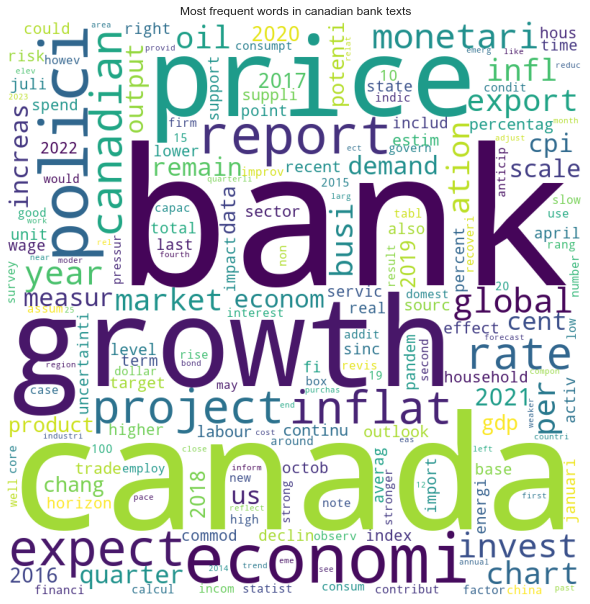

In [265]:
from wordcloud import WordCloud

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate_from_frequencies(tokens_sorted)
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Most frequent words in canadian bank texts")
plt.show()

In [264]:
import plotly.express as px

tokens_df = pd.DataFrame.from_dict(tokens_sorted, orient="index", columns=["word frequency"])

fig = px.bar(tokens_df.iloc[30:0:-1], orientation='h', x="word frequency", labels={'index':'Word'}, title="Frequency of the top 30 words in the canadian bank texts", text_auto='.2', color="word frequency")
#plt.title("Frequency of the top 30 words in the canadian bank texts")
fig.show(renderer="notebook")

In [35]:
import re

lmdict = {'Negative': ['abandon', 'abandoned', 'abandoning', 'abandonment', 'abandonments', 'abandons', 'abdicated',
                       'abdicates', 'abdicating', 'abdication', 'abdications', 'aberrant', 'aberration', 'aberrational',
                       'aberrations', 'abetting', 'abnormal', 'abnormalities', 'abnormality', 'abnormally', 'abolish',
                       'abolished', 'abolishes', 'abolishing', 'abrogate', 'abrogated', 'abrogates', 'abrogating',
                       'abrogation', 'abrogations', 'abrupt', 'abruptly', 'abruptness', 'absence', 'absences',
                       'absenteeism', 'abuse', 'abused', 'abuses', 'abusing', 'abusive', 'abusively', 'abusiveness',
                       'accident', 'accidental', 'accidentally', 'accidents', 'accusation', 'accusations', 'accuse',
                       'accused', 'accuses', 'accusing', 'acquiesce', 'acquiesced', 'acquiesces', 'acquiescing',
                       'acquit', 'acquits', 'acquittal', 'acquittals', 'acquitted', 'acquitting', 'adulterate',
                       'adulterated', 'adulterating', 'adulteration', 'adulterations', 'adversarial', 'adversaries',
                       'adversary', 'adverse', 'adversely', 'adversities', 'adversity', 'aftermath', 'aftermaths',
                       'against', 'aggravate', 'aggravated', 'aggravates', 'aggravating', 'aggravation', 'aggravations',
                       'alerted', 'alerting', 'alienate', 'alienated', 'alienates', 'alienating', 'alienation',
                       'alienations', 'allegation', 'allegations', 'allege', 'alleged', 'allegedly', 'alleges',
                       'alleging', 'annoy', 'annoyance', 'annoyances', 'annoyed', 'annoying', 'annoys', 'annul',
                       'annulled', 'annulling', 'annulment', 'annulments', 'annuls', 'anomalies', 'anomalous',
                       'anomalously', 'anomaly', 'anticompetitive', 'antitrust', 'argue', 'argued', 'arguing',
                       'argument', 'argumentative', 'arguments', 'arrearage', 'arrearages', 'arrears', 'arrest',
                       'arrested', 'arrests', 'artificially', 'assault', 'assaulted', 'assaulting', 'assaults',
                       'assertions', 'attrition', 'aversely', 'backdating', 'bad', 'bail', 'bailout', 'balk', 'balked',
                       'bankrupt', 'bankruptcies', 'bankruptcy', 'bankrupted', 'bankrupting', 'bankrupts', 'bans',
                       'barred', 'barrier', 'barriers', 'bottleneck', 'bottlenecks', 'boycott', 'boycotted',
                       'boycotting', 'boycotts', 'breach', 'breached', 'breaches', 'breaching', 'break', 'breakage',
                       'breakages', 'breakdown', 'breakdowns', 'breaking', 'breaks', 'bribe', 'bribed', 'briberies',
                       'bribery', 'bribes', 'bribing', 'bridge', 'broken', 'burden', 'burdened', 'burdening', 'burdens',
                       'burdensome', 'burned', 'calamities', 'calamitous', 'calamity', 'cancel', 'canceled',
                       'canceling', 'cancellation', 'cancellations', 'cancelled', 'cancelling', 'cancels', 'careless',
                       'carelessly', 'carelessness', 'catastrophe', 'catastrophes', 'catastrophic', 'catastrophically',
                       'caution', 'cautionary', 'cautioned', 'cautioning', 'cautions', 'cease', 'ceased', 'ceases',
                       'ceasing', 'censure', 'censured', 'censures', 'censuring', 'challenge', 'challenged',
                       'challenges', 'challenging', 'chargeoffs', 'circumvent', 'circumvented', 'circumventing',
                       'circumvention', 'circumventions', 'circumvents', 'claiming', 'claims', 'clawback', 'closed',
                       'closeout', 'closeouts', 'closing', 'closings', 'closure', 'closures', 'coerce', 'coerced',
                       'coerces', 'coercing', 'coercion', 'coercive', 'collapse', 'collapsed', 'collapses',
                       'collapsing', 'collision', 'collisions', 'collude', 'colluded', 'colludes', 'colluding',
                       'collusion', 'collusions', 'collusive', 'complain', 'complained', 'complaining', 'complains',
                       'complaint', 'complaints', 'complicate', 'complicated', 'complicates', 'complicating',
                       'complication', 'complications', 'compulsion', 'concealed', 'concealing', 'concede', 'conceded',
                       'concedes', 'conceding', 'concern', 'concerned', 'concerns', 'conciliating', 'conciliation',
                       'conciliations', 'condemn', 'condemnation', 'condemnations', 'condemned', 'condemning',
                       'condemns', 'condone', 'condoned', 'confess', 'confessed', 'confesses', 'confessing',
                       'confession', 'confine', 'confined', 'confinement', 'confinements', 'confines', 'confining',
                       'confiscate', 'confiscated', 'confiscates', 'confiscating', 'confiscation', 'confiscations',
                       'conflict', 'conflicted', 'conflicting', 'conflicts', 'confront', 'confrontation',
                       'confrontational', 'confrontations', 'confronted', 'confronting', 'confronts', 'confuse',
                       'confused', 'confuses', 'confusing', 'confusingly', 'confusion', 'conspiracies', 'conspiracy',
                       'conspirator', 'conspiratorial', 'conspirators', 'conspire', 'conspired', 'conspires',
                       'conspiring', 'contempt', 'contend', 'contended', 'contending', 'contends', 'contention',
                       'contentions', 'contentious', 'contentiously', 'contested', 'contesting', 'contraction',
                       'contractions', 'contradict', 'contradicted', 'contradicting', 'contradiction', 'contradictions',
                       'contradictory', 'contradicts', 'contrary', 'controversial', 'controversies', 'controversy',
                       'convict', 'convicted', 'convicting', 'conviction', 'convictions', 'corrected', 'correcting',
                       'correction', 'corrections', 'corrects', 'corrupt', 'corrupted', 'corrupting', 'corruption',
                       'corruptions', 'corruptly', 'corruptness', 'costly', 'counterclaim', 'counterclaimed',
                       'counterclaiming', 'counterclaims', 'counterfeit', 'counterfeited', 'counterfeiter',
                       'counterfeiters', 'counterfeiting', 'counterfeits', 'countermeasure', 'countermeasures', 'crime',
                       'crimes', 'criminal', 'criminally', 'criminals', 'crises', 'crisis', 'critical', 'critically',
                       'criticism', 'criticisms', 'criticize', 'criticized', 'criticizes', 'criticizing', 'crucial',
                       'crucially', 'culpability', 'culpable', 'culpably', 'cumbersome', 'curtail', 'curtailed',
                       'curtailing', 'curtailment', 'curtailments', 'curtails', 'cut', 'cutback', 'cutbacks',
                       'cyberattack', 'cyberattacks', 'cyberbullying', 'cybercrime', 'cybercrimes', 'cybercriminal',
                       'cybercriminals', 'damage', 'damaged', 'damages', 'damaging', 'dampen', 'dampened', 'danger',
                       'dangerous', 'dangerously', 'dangers', 'deadlock', 'deadlocked', 'deadlocking', 'deadlocks',
                       'deadweight', 'deadweights', 'debarment', 'debarments', 'debarred', 'deceased', 'deceit',
                       'deceitful', 'deceitfulness', 'deceive', 'deceived', 'deceives', 'deceiving', 'deception',
                       'deceptions', 'deceptive', 'deceptively', 'decline', 'declined', 'declines', 'declining',
                       'deface', 'defaced', 'defacement', 'defamation', 'defamations', 'defamatory', 'defame',
                       'defamed', 'defames', 'defaming', 'default', 'defaulted', 'defaulting', 'defaults', 'defeat',
                       'defeated', 'defeating', 'defeats', 'defect', 'defective', 'defects', 'defend', 'defendant',
                       'defendants', 'defended', 'defending', 'defends', 'defensive', 'defer', 'deficiencies',
                       'deficiency', 'deficient', 'deficit', 'deficits', 'defraud', 'defrauded', 'defrauding',
                       'defrauds', 'defunct', 'degradation', 'degradations', 'degrade', 'degraded', 'degrades',
                       'degrading', 'delay', 'delayed', 'delaying', 'delays', 'deleterious', 'deliberate',
                       'deliberated', 'deliberately', 'delinquencies', 'delinquency', 'delinquent', 'delinquently',
                       'delinquents', 'delist', 'delisted', 'delisting', 'delists', 'demise', 'demised', 'demises',
                       'demising', 'demolish', 'demolished', 'demolishes', 'demolishing', 'demolition', 'demolitions',
                       'demote', 'demoted', 'demotes', 'demoting', 'demotion', 'demotions', 'denial', 'denials',
                       'denied', 'denies', 'denigrate', 'denigrated', 'denigrates', 'denigrating', 'denigration',
                       'deny', 'denying', 'deplete', 'depleted', 'depletes', 'depleting', 'depletion', 'depletions',
                       'deprecation', 'depress', 'depressed', 'depresses', 'depressing', 'deprivation', 'deprive',
                       'deprived', 'deprives', 'depriving', 'derelict', 'dereliction', 'derogatory', 'destabilization',
                       'destabilize', 'destabilized', 'destabilizing', 'destroy', 'destroyed', 'destroying', 'destroys',
                       'destruction', 'destructive', 'detain', 'detained', 'detention', 'detentions', 'deter',
                       'deteriorate', 'deteriorated', 'deteriorates', 'deteriorating', 'deterioration',
                       'deteriorations', 'deterred', 'deterrence', 'deterrences', 'deterrent', 'deterrents',
                       'deterring', 'deters', 'detract', 'detracted', 'detracting', 'detriment', 'detrimental',
                       'detrimentally', 'detriments', 'devalue', 'devalued', 'devalues', 'devaluing', 'devastate',
                       'devastated', 'devastating', 'devastation', 'deviate', 'deviated', 'deviates', 'deviating',
                       'deviation', 'deviations', 'devolve', 'devolved', 'devolves', 'devolving', 'difficult',
                       'difficulties', 'difficultly', 'difficulty', 'diminish', 'diminished', 'diminishes',
                       'diminishing', 'diminution', 'disadvantage', 'disadvantaged', 'disadvantageous', 'disadvantages',
                       'disaffiliation', 'disagree', 'disagreeable', 'disagreed', 'disagreeing', 'disagreement',
                       'disagreements', 'disagrees', 'disallow', 'disallowance', 'disallowances', 'disallowed',
                       'disallowing', 'disallows', 'disappear', 'disappearance', 'disappearances', 'disappeared',
                       'disappearing', 'disappears', 'disappoint', 'disappointed', 'disappointing', 'disappointingly',
                       'disappointment', 'disappointments', 'disappoints', 'disapproval', 'disapprovals', 'disapprove',
                       'disapproved', 'disapproves', 'disapproving', 'disassociates', 'disassociating',
                       'disassociation', 'disassociations', 'disaster', 'disasters', 'disastrous', 'disastrously',
                       'disavow', 'disavowal', 'disavowed', 'disavowing', 'disavows', 'disciplinary', 'disclaim',
                       'disclaimed', 'disclaimer', 'disclaimers', 'disclaiming', 'disclaims', 'disclose', 'disclosed',
                       'discloses', 'disclosing', 'discontinuance', 'discontinuances', 'discontinuation',
                       'discontinuations', 'discontinue', 'discontinued', 'discontinues', 'discontinuing', 'discourage',
                       'discouraged', 'discourages', 'discouraging', 'discredit', 'discredited', 'discrediting',
                       'discredits', 'discrepancies', 'discrepancy', 'disfavor', 'disfavored', 'disfavoring',
                       'disfavors', 'disgorge', 'disgorged', 'disgorgement', 'disgorgements', 'disgorges', 'disgorging',
                       'disgrace', 'disgraceful', 'disgracefully', 'dishonest', 'dishonestly', 'dishonesty', 'dishonor',
                       'dishonorable', 'dishonorably', 'dishonored', 'dishonoring', 'dishonors', 'disincentives',
                       'disinterested', 'disinterestedly', 'disinterestedness', 'disloyal', 'disloyally', 'disloyalty',
                       'dismal', 'dismally', 'dismiss', 'dismissal', 'dismissals', 'dismissed', 'dismisses',
                       'dismissing', 'disorderly', 'disparage', 'disparaged', 'disparagement', 'disparagements',
                       'disparages', 'disparaging', 'disparagingly', 'disparities', 'disparity', 'displace',
                       'displaced', 'displacement', 'displacements', 'displaces', 'displacing', 'dispose', 'dispossess',
                       'dispossessed', 'dispossesses', 'dispossessing', 'disproportion', 'disproportional',
                       'disproportionate', 'disproportionately', 'dispute', 'disputed', 'disputes', 'disputing',
                       'disqualification', 'disqualifications', 'disqualified', 'disqualifies', 'disqualify',
                       'disqualifying', 'disregard', 'disregarded', 'disregarding', 'disregards', 'disreputable',
                       'disrepute', 'disrupt', 'disrupted', 'disrupting', 'disruption', 'disruptions', 'disruptive',
                       'disrupts', 'dissatisfaction', 'dissatisfied', 'dissent', 'dissented', 'dissenter', 'dissenters',
                       'dissenting', 'dissents', 'dissident', 'dissidents', 'dissolution', 'dissolutions', 'distort',
                       'distorted', 'distorting', 'distortion', 'distortions', 'distorts', 'distract', 'distracted',
                       'distracting', 'distraction', 'distractions', 'distracts', 'distress', 'distressed', 'disturb',
                       'disturbance', 'disturbances', 'disturbed', 'disturbing', 'disturbs', 'diversion', 'divert',
                       'diverted', 'diverting', 'diverts', 'divest', 'divested', 'divesting', 'divestiture',
                       'divestitures', 'divestment', 'divestments', 'divests', 'divorce', 'divorced', 'divulge',
                       'divulged', 'divulges', 'divulging', 'doubt', 'doubted', 'doubtful', 'doubts', 'downgrade',
                       'downgraded', 'downgrades', 'downgrading', 'downsize', 'downsized', 'downsizes', 'downsizing',
                       'downsizings', 'downtime', 'downtimes', 'downturn', 'downturns', 'downward', 'downwards', 'drag',
                       'drastic', 'drastically', 'drawback', 'drawbacks', 'drop', 'dropped', 'drought', 'droughts', 'duress',
                       'dysfunction', 'dysfunctional', 'dysfunctions', 'easing', 'egregious', 'egregiously', 'embargo',
                       'embargoed', 'embargoes', 'embargoing', 'embarrass', 'embarrassed', 'embarrasses',
                       'embarrassing', 'embarrassment', 'embarrassments', 'embezzle', 'embezzled', 'embezzlement',
                       'embezzlements', 'embezzler', 'embezzles', 'embezzling', 'encroach', 'encroached', 'encroaches',
                       'encroaching', 'encroachment', 'encroachments', 'encumber', 'encumbered', 'encumbering',
                       'encumbers', 'encumbrance', 'encumbrances', 'endanger', 'endangered', 'endangering',
                       'endangerment', 'endangers', 'enjoin', 'enjoined', 'enjoining', 'enjoins', 'erode', 'eroded',
                       'erodes', 'eroding', 'erosion', 'erratic', 'erratically', 'erred', 'erring', 'erroneous',
                       'erroneously', 'error', 'errors', 'errs', 'escalate', 'escalated', 'escalates', 'escalating',
                       'evade', 'evaded', 'evades', 'evading', 'evasion', 'evasions', 'evasive', 'evict', 'evicted',
                       'evicting', 'eviction', 'evictions', 'evicts', 'exacerbate', 'exacerbated', 'exacerbates',
                       'exacerbating', 'exacerbation', 'exacerbations', 'exaggerate', 'exaggerated', 'exaggerates',
                       'exaggerating', 'exaggeration', 'excessive', 'excessively', 'exculpate', 'exculpated',
                       'exculpates', 'exculpating', 'exculpation', 'exculpations', 'exculpatory', 'exonerate',
                       'exonerated', 'exonerates', 'exonerating', 'exoneration', 'exonerations', 'exploit',
                       'exploitation', 'exploitations', 'exploitative', 'exploited', 'exploiting', 'exploits', 'expose',
                       'exposed', 'exposes', 'exposing', 'expropriate', 'expropriated', 'expropriates', 'expropriating',
                       'expropriation', 'expropriations', 'expulsion', 'expulsions', 'extenuating', 'fail', 'failed',
                       'failing', 'failings', 'fails', 'failure', 'failures', 'fallout', 'false', 'falsely',
                       'falsification', 'falsifications', 'falsified', 'falsifies', 'falsify', 'falsifying', 'falsity',
                       'fatalities', 'fatality', 'fatally', 'fault', 'faulted', 'faults', 'faulty', 'fear', 'fears',
                       'felonies', 'felonious', 'felony', 'fictitious', 'fined', 'fines', 'fired', 'firing', 'flaw',
                       'flawed', 'flaws', 'forbid', 'forbidden', 'forbidding', 'forbids', 'force', 'forced', 'forcing',
                       'foreclose', 'foreclosed', 'forecloses', 'foreclosing', 'foreclosure', 'foreclosures', 'forego',
                       'foregoes', 'foregone', 'forestall', 'forestalled', 'forestalling', 'forestalls', 'forfeit',
                       'forfeited', 'forfeiting', 'forfeits', 'forfeiture', 'forfeitures', 'forgers', 'forgery',
                       'fraud', 'frauds', 'fraudulence', 'fraudulent', 'fraudulently', 'frivolous', 'frivolously',
                       'frustrate', 'frustrated', 'frustrates', 'frustrating', 'frustratingly', 'frustration',
                       'frustrations', 'fugitive', 'fugitives', 'gratuitous', 'gratuitously', 'grievance', 'grievances',
                       'grossly', 'groundless', 'guilty', 'halt', 'halted', 'hamper', 'hampered', 'hampering',
                       'hampers', 'harass', 'harassed', 'harassing', 'harassment', 'hardship', 'hardships', 'harm',
                       'harmed', 'harmful', 'harmfully', 'harming', 'harms', 'harsh', 'harsher', 'harshest', 'harshly',
                       'harshness', 'hazard', 'hazardous', 'hazards', 'hinder', 'hindered', 'hindering', 'hinders',
                       'hindrance', 'hindrances', 'hostile', 'hostility', 'hurt', 'hurting', 'idle', 'idled', 'idling',
                       'ignore', 'ignored', 'ignores', 'ignoring', 'ill', 'illegal', 'illegalities', 'illegality',
                       'illegally', 'illegible', 'illicit', 'illicitly', 'illiquid', 'illiquidity', 'imbalance',
                       'imbalances', 'immature', 'immoral', 'impair', 'impaired', 'impairing', 'impairment',
                       'impairments', 'impairs', 'impasse', 'impasses', 'impede', 'impeded', 'impedes', 'impediment',
                       'impediments', 'impeding', 'impending', 'imperative', 'imperfection', 'imperfections', 'imperil',
                       'impermissible', 'implicate', 'implicated', 'implicates', 'implicating', 'impossibility',
                       'impossible', 'impound', 'impounded', 'impounding', 'impounds', 'impracticable', 'impractical',
                       'impracticalities', 'impracticality', 'imprisonment', 'improper', 'improperly', 'improprieties',
                       'impropriety', 'imprudent', 'imprudently', 'inability', 'inaccessible', 'inaccuracies',
                       'inaccuracy', 'inaccurate', 'inaccurately', 'inaction', 'inactions', 'inactivate', 'inactivated',
                       'inactivates', 'inactivating', 'inactivation', 'inactivations', 'inactivity', 'inadequacies',
                       'inadequacy', 'inadequate', 'inadequately', 'inadvertent', 'inadvertently', 'inadvisability',
                       'inadvisable', 'inappropriate', 'inappropriately', 'inattention', 'incapable', 'incapacitated',
                       'incapacity', 'incarcerate', 'incarcerated', 'incarcerates', 'incarcerating', 'incarceration',
                       'incarcerations', 'incidence', 'incidences', 'incident', 'incidents', 'incompatibilities',
                       'incompatibility', 'incompatible', 'incompetence', 'incompetency', 'incompetent',
                       'incompetently', 'incompetents', 'incomplete', 'incompletely', 'incompleteness', 'inconclusive',
                       'inconsistencies', 'inconsistency', 'inconsistent', 'inconsistently', 'inconvenience',
                       'inconveniences', 'inconvenient', 'incorrect', 'incorrectly', 'incorrectness', 'indecency',
                       'indecent', 'indefeasible', 'indefeasibly', 'indict', 'indictable', 'indicted', 'indicting',
                       'indictment', 'indictments', 'ineffective', 'ineffectively', 'ineffectiveness', 'inefficiencies',
                       'inefficiency', 'inefficient', 'inefficiently', 'ineligibility', 'ineligible', 'inequitable',
                       'inequitably', 'inequities', 'inequity', 'inevitable', 'inexperience', 'inexperienced',
                       'inferior', 'inflicted', 'infraction', 'infractions', 'infringe', 'infringed', 'infringement',
                       'infringements', 'infringes', 'infringing', 'inhibited', 'inimical', 'injunction', 'injunctions',
                       'injure', 'injured', 'injures', 'injuries', 'injuring', 'injurious', 'injury', 'inordinate',
                       'inordinately', 'inquiry', 'insecure', 'insensitive', 'insolvencies', 'insolvency', 'insolvent',
                       'instability', 'insubordination', 'insufficiency', 'insufficient', 'insufficiently',
                       'insurrection', 'insurrections', 'intentional', 'interfere', 'interfered', 'interference',
                       'interferences', 'interferes', 'interfering', 'intermittent', 'intermittently', 'interrupt',
                       'interrupted', 'interrupting', 'interruption', 'interruptions', 'interrupts', 'intimidation',
                       'intrusion', 'invalid', 'invalidate', 'invalidated', 'invalidates', 'invalidating',
                       'invalidation', 'invalidity', 'investigate', 'investigated', 'investigates', 'investigating',
                       'investigation', 'investigations', 'involuntarily', 'involuntary', 'irreconcilable',
                       'irreconcilably', 'irrecoverable', 'irrecoverably', 'irregular', 'irregularities',
                       'irregularity', 'irregularly', 'irreparable', 'irreparably', 'irreversible', 'jeopardize',
                       'jeopardized', 'justifiable', 'kickback', 'kickbacks', 'knowingly', 'lack', 'lacked', 'lacking',
                       'lackluster', 'lacks', 'lag', 'lagged', 'lagging', 'lags', 'lapse', 'lapsed', 'lapses',
                       'lapsing', 'late', 'laundering', 'layoff', 'layoffs', 'lie', 'limitation', 'limitations',
                       'lingering', 'liquidate', 'liquidated', 'liquidates', 'liquidating', 'liquidation',
                       'liquidations', 'liquidator', 'liquidators', 'litigant', 'litigants', 'litigate', 'litigated',
                       'litigates', 'litigating', 'litigation', 'litigations', 'lockout', 'lockouts', 'lose', 'loses',
                       'losing', 'loss', 'losses', 'lost', 'lying', 'malfeasance', 'malfunction', 'malfunctioned',
                       'malfunctioning', 'malfunctions', 'malice', 'malicious', 'maliciously', 'malpractice',
                       'manipulate', 'manipulated', 'manipulates', 'manipulating', 'manipulation', 'manipulations',
                       'manipulative', 'markdown', 'markdowns', 'misapplication', 'misapplications', 'misapplied',
                       'misapplies', 'misapply', 'misapplying', 'misappropriate', 'misappropriated', 'misappropriates',
                       'misappropriating', 'misappropriation', 'misappropriations', 'misbranded', 'miscalculate',
                       'miscalculated', 'miscalculates', 'miscalculating', 'miscalculation', 'miscalculations',
                       'mischaracterization', 'mischief', 'misclassification', 'misclassifications', 'misclassified',
                       'misclassify', 'miscommunication', 'misconduct', 'misdated', 'misdemeanor', 'misdemeanors',
                       'misdirected', 'mishandle', 'mishandled', 'mishandles', 'mishandling', 'misinform',
                       'misinformation', 'misinformed', 'misinforming', 'misinforms', 'misinterpret',
                       'misinterpretation', 'misinterpretations', 'misinterpreted', 'misinterpreting', 'misinterprets',
                       'misjudge', 'misjudged', 'misjudges', 'misjudging', 'misjudgment', 'misjudgments', 'mislabel',
                       'mislabeled', 'mislabeling', 'mislabelled', 'mislabels', 'mislead', 'misleading', 'misleadingly',
                       'misleads', 'misled', 'mismanage', 'mismanaged', 'mismanagement', 'mismanages', 'mismanaging',
                       'mismatch', 'mismatched', 'mismatches', 'mismatching', 'misplaced', 'misprice', 'mispricing',
                       'mispricings', 'misrepresent', 'misrepresentation', 'misrepresentations', 'misrepresented',
                       'misrepresenting', 'misrepresents', 'miss', 'missed', 'misses', 'misstate', 'misstated',
                       'misstatement', 'misstatements', 'misstates', 'misstating', 'misstep', 'missteps', 'mistake',
                       'mistaken', 'mistakenly', 'mistakes', 'mistaking', 'mistrial', 'mistrials', 'misunderstand',
                       'misunderstanding', 'misunderstandings', 'misunderstood', 'misuse', 'misused', 'misuses',
                       'misusing', 'monopolistic', 'monopolists', 'monopolization', 'monopolize', 'monopolized',
                       'monopolizes', 'monopolizing', 'monopoly', 'moratoria', 'moratorium', 'moratoriums',
                       'mothballed', 'mothballing', 'negative', 'negatively', 'negatives', 'neglect', 'neglected',
                       'neglectful', 'neglecting', 'neglects', 'negligence', 'negligences', 'negligent', 'negligently',
                       'nonattainment', 'noncompetitive', 'noncompliance', 'noncompliances', 'noncompliant',
                       'noncomplying', 'nonconforming', 'nonconformities', 'nonconformity', 'nondisclosure',
                       'nonfunctional', 'nonpayment', 'nonpayments', 'nonperformance', 'nonperformances',
                       'nonperforming', 'nonproducing', 'nonproductive', 'nonrecoverable', 'nonrenewal', 'nuisance',
                       'nuisances', 'nullification', 'nullifications', 'nullified', 'nullifies', 'nullify',
                       'nullifying', 'objected', 'objecting', 'objection', 'objectionable', 'objectionably',
                       'objections', 'obscene', 'obscenity', 'obsolescence', 'obsolete', 'obstacle', 'obstacles',
                       'obstruct', 'obstructed', 'obstructing', 'obstruction', 'obstructions', 'offence', 'offences',
                       'offend', 'offended', 'offender', 'offenders', 'offending', 'offends', 'omission', 'omissions',
                       'omit', 'omits', 'omitted', 'omitting', 'onerous', 'opportunistic', 'opportunistically',
                       'oppose', 'opposed', 'opposes', 'opposing', 'opposition', 'oppositions', 'outage', 'outages',
                       'outdated', 'outmoded', 'overage', 'overages', 'overbuild', 'overbuilding', 'overbuilds',
                       'overbuilt', 'overburden', 'overburdened', 'overburdening', 'overcapacities', 'overcapacity',
                       'overcharge', 'overcharged', 'overcharges', 'overcharging', 'overcome', 'overcomes',
                       'overcoming', 'overdue', 'overestimate', 'overestimated', 'overestimates', 'overestimating',
                       'overestimation', 'overestimations', 'overload', 'overloaded', 'overloading', 'overloads',
                       'overlook', 'overlooked', 'overlooking', 'overlooks', 'overpaid', 'overpayment', 'overpayments',
                       'overproduced', 'overproduces', 'overproducing', 'overproduction', 'overrun', 'overrunning',
                       'overruns', 'overshadow', 'overshadowed', 'overshadowing', 'overshadows', 'overstate',
                       'overstated', 'overstatement', 'overstatements', 'overstates', 'overstating', 'oversupplied',
                       'oversupplies', 'oversupply', 'oversupplying', 'overtly', 'overturn', 'overturned',
                       'overturning', 'overturns', 'overvalue', 'overvalued', 'overvaluing', 'panic', 'panics',
                       'penalize', 'penalized', 'penalizes', 'penalizing', 'penalties', 'penalty', 'peril', 'perils',
                       'perjury', 'perpetrate', 'perpetrated', 'perpetrates', 'perpetrating', 'perpetration', 'persist',
                       'persisted', 'persistence', 'persistent', 'persistently', 'persisting', 'persists', 'pervasive',
                       'pervasively', 'pervasiveness', 'petty', 'picket', 'picketed', 'picketing', 'plaintiff',
                       'plaintiffs', 'plea', 'plead', 'pleaded', 'pleading', 'pleadings', 'pleads', 'pleas', 'pled',
                       'poor', 'poorly', 'poses', 'posing', 'postpone', 'postponed', 'postponement', 'postponements',
                       'postpones', 'postponing', 'precipitated', 'precipitous', 'precipitously', 'preclude',
                       'precluded', 'precludes', 'precluding', 'predatory', 'prejudice', 'prejudiced', 'prejudices',
                       'prejudicial', 'prejudicing', 'premature', 'prematurely', 'pressing', 'pretrial', 'preventing',
                       'prevention', 'prevents', 'problem', 'problematic', 'problematical', 'problems', 'prolong',
                       'prolongation', 'prolongations', 'prolonged', 'prolonging', 'prolongs', 'prone', 'prosecute',
                       'prosecuted', 'prosecutes', 'prosecuting', 'prosecution', 'prosecutions', 'protest', 'protested',
                       'protester', 'protesters', 'protesting', 'protestor', 'protestors', 'protests', 'protracted',
                       'protraction', 'provoke', 'provoked', 'provokes', 'provoking', 'punished', 'punishes',
                       'punishing', 'punishment', 'punishments', 'punitive', 'purport', 'purported', 'purportedly',
                       'purporting', 'purports', 'question', 'questionable', 'questionably', 'questioned',
                       'questioning', 'questions', 'quit', 'quitting', 'racketeer', 'racketeering', 'rationalization',
                       'rationalizations', 'rationalize', 'rationalized', 'rationalizes', 'rationalizing',
                       'reassessment', 'reassessments', 'reassign', 'reassigned', 'reassigning', 'reassignment',
                       'reassignments', 'reassigns', 'recall', 'recalled', 'recalling', 'recalls', 'recession',
                       'recessionary', 'recessions', 'reckless', 'recklessly', 'recklessness', 'redact', 'redacted',
                       'redacting', 'redaction', 'redactions', 'redefault', 'redefaulted', 'redefaults', 'redress',
                       'redressed', 'redresses', 'redressing', 'refusal', 'refusals', 'refuse', 'refused', 'refuses',
                       'refusing', 'reject', 'rejected', 'rejecting', 'rejection', 'rejections', 'rejects',
                       'relinquish', 'relinquished', 'relinquishes', 'relinquishing', 'relinquishment',
                       'relinquishments', 'reluctance', 'reluctant', 'renegotiate', 'renegotiated', 'renegotiates',
                       'renegotiating', 'renegotiation', 'renegotiations', 'renounce', 'renounced', 'renouncement',
                       'renouncements', 'renounces', 'renouncing', 'reparation', 'reparations', 'repossessed',
                       'repossesses', 'repossessing', 'repossession', 'repossessions', 'repudiate', 'repudiated',
                       'repudiates', 'repudiating', 'repudiation', 'repudiations', 'resign', 'resignation',
                       'resignations', 'resigned', 'resigning', 'resigns', 'restate', 'restated', 'restatement',
                       'restatements', 'restates', 'restating', 'restructure', 'restructured', 'restructures',
                       'restructuring', 'restructurings', 'retaliate', 'retaliated', 'retaliates', 'retaliating',
                       'retaliation', 'retaliations', 'retaliatory', 'retribution', 'retributions', 'revocation',
                       'revocations', 'revoke', 'revoked', 'revokes', 'revoking', 'ridicule', 'ridiculed', 'ridicules',
                       'ridiculing', 'riskier', 'riskiest', 'risky', 'sabotage', 'sacrifice', 'sacrificed',
                       'sacrifices', 'sacrificial', 'sacrificing', 'scandalous', 'scandals', 'scrutinize',
                       'scrutinized', 'scrutinizes', 'scrutinizing', 'scrutiny', 'secrecy', 'seize', 'seized', 'seizes',
                       'seizing', 'sentenced', 'sentencing', 'serious', 'seriously', 'seriousness', 'setback',
                       'setbacks', 'sever', 'severe', 'severed', 'severely', 'severities', 'severity', 'sharply',
                       'shocked', 'shortage', 'shortages', 'shortfall', 'shortfalls', 'shrinkage', 'shrinkages', 'shut',
                       'shutdown', 'shutdowns', 'shuts', 'shutting', 'slander', 'slandered', 'slanderous', 'slanders',
                       'slippage', 'slippages', 'slow', 'slowdown', 'slowdowns', 'slowed', 'slower', 'slowest',
                       'slowing', 'slowly', 'slowness', 'sluggish', 'sluggishly', 'sluggishness', 'solvencies',
                       'solvency', 'spam', 'spammers', 'spamming', 'staggering', 'stagnant', 'stagnate', 'stagnated',
                       'stagnates', 'stagnating', 'stagnation', 'standstill', 'standstills', 'stolen', 'stoppage',
                       'stoppages', 'stopped', 'stopping', 'stops', 'strain', 'strained', 'straining', 'strains',
                       'stress', 'stressed', 'stresses', 'stressful', 'stressing', 'stringent', 'strong', 'subjected',
                       'subjecting', 'subjection', 'subpoena', 'subpoenaed', 'subpoenas', 'substandard', 'sue', 'sued',
                       'sues', 'suffer', 'suffered', 'suffering', 'suffers', 'suing', 'summoned', 'summoning',
                       'summons', 'summonses', 'susceptibility', 'susceptible', 'suspect', 'suspected', 'suspects',
                       'suspend', 'suspended', 'suspending', 'suspends', 'suspension', 'suspensions', 'suspicion',
                       'suspicions', 'suspicious', 'suspiciously', 'taint', 'tainted', 'tainting', 'taints', 'tampered',
                       'tense', 'terminate', 'terminated', 'terminates', 'terminating', 'termination', 'terminations',
                       'testify', 'testifying', 'threat', 'threaten', 'threatened', 'threatening', 'threatens',
                       'threats', 'tightening', 'tolerate', 'tolerated', 'tolerates', 'tolerating', 'toleration',
                       'tortuous', 'tortuously', 'tragedies', 'tragedy', 'tragic', 'tragically', 'traumatic', 'trouble',
                       'troubled', 'troubles', 'turbulence', 'turmoil', 'unable', 'unacceptable', 'unacceptably',
                       'unaccounted', 'unannounced', 'unanticipated', 'unapproved', 'unattractive', 'unauthorized',
                       'unavailability', 'unavailable', 'unavoidable', 'unavoidably', 'unaware', 'uncollectable',
                       'uncollected', 'uncollectibility', 'uncollectible', 'uncollectibles', 'uncompetitive',
                       'uncompleted', 'unconscionable', 'unconscionably', 'uncontrollable', 'uncontrollably',
                       'uncontrolled', 'uncorrected', 'uncover', 'uncovered', 'uncovering', 'uncovers', 'undeliverable',
                       'undelivered', 'undercapitalized', 'undercut', 'undercuts', 'undercutting', 'underestimate',
                       'underestimated', 'underestimates', 'underestimating', 'underestimation', 'underfunded',
                       'underinsured', 'undermine', 'undermined', 'undermines', 'undermining', 'underpaid',
                       'underpayment', 'underpayments', 'underpays', 'underperform', 'underperformance',
                       'underperformed', 'underperforming', 'underperforms', 'underproduced', 'underproduction',
                       'underreporting', 'understate', 'understated', 'understatement', 'understatements',
                       'understates', 'understating', 'underutilization', 'underutilized', 'undesirable', 'undesired',
                       'undetected', 'undetermined', 'undisclosed', 'undocumented', 'undue', 'unduly', 'uneconomic',
                       'uneconomical', 'uneconomically', 'unemployed', 'unemployment', 'unethical', 'unethically',
                       'unexcused', 'unexpected', 'unexpectedly', 'unfair', 'unfairly', 'unfavorability', 'unfavorable',
                       'unfavorably', 'unfavourable', 'unfeasible', 'unfit', 'unfitness', 'unforeseeable', 'unforeseen',
                       'unforseen', 'unfortunate', 'unfortunately', 'unfounded', 'unfriendly', 'unfulfilled',
                       'unfunded', 'uninsured', 'unintended', 'unintentional', 'unintentionally', 'unjust',
                       'unjustifiable', 'unjustifiably', 'unjustified', 'unjustly', 'unknowing', 'unknowingly',
                       'unlawful', 'unlawfully', 'unlicensed', 'unliquidated', 'unmarketable', 'unmerchantable',
                       'unmeritorious', 'unnecessarily', 'unnecessary', 'unneeded', 'unobtainable', 'unoccupied',
                       'unpaid', 'unperformed', 'unplanned', 'unpopular', 'unpredictability', 'unpredictable',
                       'unpredictably', 'unpredicted', 'unproductive', 'unprofitability', 'unprofitable', 'unqualified',
                       'unrealistic', 'unreasonable', 'unreasonableness', 'unreasonably', 'unreceptive',
                       'unrecoverable', 'unrecovered', 'unreimbursed', 'unreliable', 'unremedied', 'unreported',
                       'unresolved', 'unrest', 'unsafe', 'unsalable', 'unsaleable', 'unsatisfactory', 'unsatisfied',
                       'unsavory', 'unscheduled', 'unsellable', 'unsold', 'unsound', 'unstabilized', 'unstable',
                       'unsubstantiated', 'unsuccessful', 'unsuccessfully', 'unsuitability', 'unsuitable', 'unsuitably',
                       'unsuited', 'unsure', 'unsuspected', 'unsuspecting', 'unsustainable', 'untenable', 'untimely',
                       'untrusted', 'untruth', 'untruthful', 'untruthfully', 'untruthfulness', 'untruths', 'unusable',
                       'unwanted', 'unwarranted', 'unwelcome', 'unwilling', 'unwillingness', 'upset', 'urgency',
                       'urgent', 'usurious', 'usurp', 'usurped', 'usurping', 'usurps', 'usury', 'vandalism', 'verdict',
                       'verdicts', 'vetoed', 'victims', 'violate', 'violated', 'violates', 'violating', 'violation',
                       'violations', 'violative', 'violator', 'violators', 'violence', 'violent', 'violently',
                       'vitiate', 'vitiated', 'vitiates', 'vitiating', 'vitiation', 'voided', 'voiding', 'volatile',
                       'volatility', 'vulnerabilities', 'vulnerability', 'vulnerable', 'vulnerably', 'warn', 'warned',
                       'warning', 'warnings', 'warns', 'wasted', 'wasteful', 'wasting', 'weak', 'weaken', 'weakened',
                       'weakening', 'weakens', 'weaker', 'weakest', 'weakly', 'weakness', 'weaknesses', 'willfully',
                       'worries', 'worry', 'worrying', 'worse', 'worsen', 'worsened', 'worsening', 'worsens', 'worst',
                       'worthless', 'writedown', 'writedowns', 'writeoff', 'writeoffs', 'wrong', 'wrongdoing',
                       'wrongdoings', 'wrongful', 'wrongfully', 'wrongly',
                       'negative', 'negatives', 'fail', 'fails', 'failing', 'failure', 'weak', 'weakness', 'weaknesses',
                       'difficult', 'difficulty', 'hurdle', 'hurdles', 'obstacle', 'obstacles', 'slump', 'slumps',
                       'slumping', 'slumped', 'uncertain', 'uncertainty', 'unsettled', 'unfavorable', 'downturn',
                       'depressed', 'disappoint', 'disappoints', 'disappointing', 'disappointed', 'disappointment',
                       'risk', 'risks', 'risky', 'threat', 'threats', 'penalty', 'penalties', 'down', 'decrease',
                       'decreases', 'decreasing', 'decreased', 'decline', 'declines', 'declining', 'declined', 'fall',
                       'falls', 'falling', 'fell', 'fallen', 'drop', 'drops', 'dropping', 'dropped', 'deteriorate',
                       'deteriorates', 'deteriorating', 'deteriorated', 'worsen', 'worsens', 'worsening', 'weaken',
                       'weakens', 'weakening', 'weakened', 'worse', 'worst', 'low', 'lower', 'lowest', 'less', 'least',
                       'smaller', 'smallest', 'shrink', 'shrinks', 'shrinking', 'shrunk', 'below', 'under', 'challenge',
                       'challenges', 'challenging', 'challenged'
                      ],
          'Positive': ['able', 'abundance', 'abundant', 'acclaimed', 'accomplish', 'accomplished', 'accomplishes',
                       'accomplishing', 'accomplishment', 'accomplishments', 'achieve', 'achieved', 'achievement',
                       'achievements', 'achieves', 'achieving', 'adequately', 'advancement', 'advancements', 'advances',
                       'advancing', 'advantage', 'advantaged', 'advantageous', 'advantageously', 'advantages',
                       'alliance', 'alliances', 'assure', 'assured', 'assures', 'assuring', 'attain', 'attained',
                       'attaining', 'attainment', 'attainments', 'attains', 'attractive', 'attractiveness', 'beautiful',
                       'beautifully', 'beneficial', 'beneficially', 'benefit', 'benefited', 'benefiting', 'benefitted',
                       'benefitting', 'best', 'better', 'bolstered', 'bolstering', 'bolsters', 'boom', 'booming',
                       'boost', 'boosted', 'breakthrough', 'breakthroughs', 'brilliant', 'charitable', 'collaborate',
                       'collaborated', 'collaborates', 'collaborating', 'collaboration', 'collaborations',
                       'collaborative', 'collaborator', 'collaborators', 'compliment', 'complimentary', 'complimented',
                       'complimenting', 'compliments', 'conclusive', 'conclusively', 'conducive', 'confident',
                       'constructive', 'constructively', 'courteous', 'creative', 'creatively', 'creativeness',
                       'creativity', 'delight', 'delighted', 'delightful', 'delightfully', 'delighting', 'delights',
                       'dependability', 'dependable', 'desirable', 'desired', 'despite', 'destined', 'diligent',
                       'diligently', 'distinction', 'distinctions', 'distinctive', 'distinctively', 'distinctiveness',
                       'dream', 'easier', 'easily', 'easy', 'effective', 'efficiencies', 'efficiency', 'efficient',
                       'efficiently', 'empower', 'empowered', 'empowering', 'empowers', 'enable', 'enabled', 'enables',
                       'enabling', 'encouraged', 'encouragement', 'encourages', 'encouraging', 'enhance', 'enhanced',
                       'enhancement', 'enhancements', 'enhances', 'enhancing', 'enjoy', 'enjoyable', 'enjoyably',
                       'enjoyed', 'enjoying', 'enjoyment', 'enjoys', 'enthusiasm', 'enthusiastic', 'enthusiastically',
                       'excellence', 'excellent', 'excelling', 'excels', 'exceptional', 'exceptionally', 'excited',
                       'excitement', 'exciting', 'exclusive', 'exclusively', 'exclusiveness', 'exclusives',
                       'exclusivity', 'exemplary', 'fantastic', 'favorable', 'favorably', 'favored', 'favoring',
                       'favorite', 'favorites', 'friendly', 'gain', 'gained', 'gaining', 'gains', 'good', 'great',
                       'greater', 'greatest', 'greatly', 'greatness', 'happiest', 'happily', 'happiness', 'happy',
                       'highest', 'honor', 'honorable', 'honored', 'honoring', 'honors', 'ideal', 'impress',
                       'impressed', 'impresses', 'impressing', 'impressive', 'impressively', 'improve', 'improved',
                       'improvement', 'improvements', 'improves', 'improving', 'incredible', 'incredibly',
                       'influential', 'informative', 'ingenuity', 'innovate', 'innovated', 'innovates', 'innovating',
                       'innovation', 'innovations', 'innovative', 'innovativeness', 'innovator', 'innovators',
                       'insightful', 'inspiration', 'inspirational', 'integrity', 'invent', 'invented', 'inventing',
                       'invention', 'inventions', 'inventive', 'inventiveness', 'inventor', 'inventors', 'leadership',
                       'leading', 'loyal', 'lucrative', 'meritorious', 'opportunities', 'opportunity', 'optimistic',
                       'outperform', 'outperformed', 'outperforming', 'outperforms', 'perfect', 'perfected',
                       'perfectly', 'perfects', 'pleasant', 'pleasantly', 'pleased', 'pleasure', 'plentiful', 'popular',
                       'popularity', 'positive', 'positively', 'preeminence', 'preeminent', 'premier', 'premiere',
                       'prestige', 'prestigious', 'proactive', 'proactively', 'proficiency', 'proficient',
                       'proficiently', 'profitability', 'profitable', 'profitably', 'progress', 'progressed',
                       'progresses', 'progressing', 'prospered', 'prospering', 'prosperity', 'prosperous', 'prospers',
                       'rebound', 'rebounded', 'rebounding', 'receptive', 'regain', 'regained', 'regaining', 'resolve',
                       'revolutionize', 'revolutionized', 'revolutionizes', 'revolutionizing', 'reward', 'rewarded',
                       'rewarding', 'rewards', 'satisfaction', 'satisfactorily', 'satisfactory', 'satisfied',
                       'satisfies', 'satisfy', 'satisfying', 'smooth', 'smoothing', 'smoothly', 'smooths', 'solves',
                       'solving', 'spectacular', 'spectacularly', 'stability', 'stabilization', 'stabilizations',
                       'stabilize', 'stabilized', 'stabilizes', 'stabilizing', 'stable', 'strength', 'strengthen',
                       'strengthened', 'strengthening', 'strengthens', 'strengths', 'strong', 'stronger', 'strongest',
                       'succeed', 'succeeded', 'succeeding', 'succeeds', 'success', 'successes', 'successful',
                       'successfully', 'superior', 'surpass', 'surpassed', 'surpasses', 'surpassing', "sustainable", 'transparency',
                       'tremendous', 'tremendously', 'unmatched', 'unparalleled', 'unsurpassed', 'upturn', 'upturns',
                       'valuable', 'versatile', 'versatility', 'vibrancy', 'vibrant', 'win', 'winner', 'winners', 'winning', 'worthy',
                       'positive', 'positives', 'success', 'successes', 'successful', 'succeed', 'succeeds',
                       'succeeding', 'succeeded', 'accomplish', 'accomplishes', 'accomplishing', 'accomplished',
                       'accomplishment', 'accomplishments', 'strong', 'strength', 'strengths', 'certain', 'certainty',
                       'definite', 'solid', 'excellent', 'good', 'leading', 'achieve', 'achieves', 'achieved',
                       'achieving', 'achievement', 'achievements', 'progress', 'progressing', 'deliver', 'delivers',
                       'delivered', 'delivering', 'leader', 'leading', 'pleased', 'reward', 'rewards', 'rewarding',
                       'rewarded', 'opportunity', 'opportunities', 'enjoy', 'enjoys', 'enjoying', 'enjoyed',
                       'encouraged', 'encouraging', 'up', 'increase', 'increases', 'increasing', 'increased', 'rise',
                       'rises', 'rising', 'rose', 'risen', 'improve', 'improves', 'improving', 'improved', 'improvement',
                       'improvements', 'strengthen', 'strengthens', 'strengthening', 'strengthened', 'stronger',
                       'strongest', 'better', 'best', 'more', 'most', 'above', 'record', 'high', 'higher', 'highest',
                       'greater', 'greatest', 'larger', 'largest', 'grow', 'grows', 'growing', 'grew', 'grown', 'growth',
                       'expand', 'expands', 'expanding', 'expanded', 'expansion', 'exceed', 'exceeds', 'exceeded',
                       'exceeding', 'beat', 'beats', 'beating']
         }

negate = ["aint", "arent", "cannot", "cant", "couldnt", "darent", "didnt", "doesnt", "ain't", "aren't", "can't",
          "couldn't", "daren't", "didn't", "doesn't", "dont", "hadnt", "hasnt", "havent", "isnt", "mightnt", "mustnt",
          "neither", "don't", "hadn't", "hasn't", "haven't", "isn't", "mightn't", "mustn't", "neednt", "needn't",
          "never", "none", "nope", "nor", "not", "nothing", "nowhere", "oughtnt", "shant", "shouldnt", "wasnt",
          "werent", "oughtn't", "shan't", "shouldn't", "wasn't", "weren't", "without", "wont", "wouldnt", "won't",
          "wouldn't", "rarely", "seldom", "despite", "no", "nobody"]

print(f"Number of positive word: {len(lmdict['Positive'])}")
print(f"Number of negative word: {len(lmdict['Negative'])}")

Number of positive word: 460
Number of negative word: 2442


In [20]:
def negated(word):
    """
    Determine if preceding word is a negation word
    """
    if word.lower() in negate:
        return True
    else:
        return False

In [21]:
def tone_count_with_negation_check(dict, article):
    """
    Count positive and negative words with negation check. Account for simple negation only for positive words.
    Simple negation is taken to be observations of one of negate words occurring within three words
    preceding a positive words.
    """
    pos_count = 0
    neg_count = 0
 
    pos_words = []
    neg_words = []
 
    input_words = re.findall(r'\b([a-zA-Z]+n\'t|[a-zA-Z]+\'s|[a-zA-Z]+)\b', article.lower())
 
    word_count = len(input_words)
 
    for i in range(0, word_count):
        if input_words[i] in dict['Negative']:
            neg_count += 1
            neg_words.append(input_words[i])
        if input_words[i] in dict['Positive']:
            if i >= 3:
                if negated(input_words[i - 1]) or negated(input_words[i - 2]) or negated(input_words[i - 3]):
                    neg_count += 1
                    neg_words.append(input_words[i] + ' (with negation)')
                else:
                    pos_count += 1
                    pos_words.append(input_words[i])
            elif i == 2:
                if negated(input_words[i - 1]) or negated(input_words[i - 2]):
                    neg_count += 1
                    neg_words.append(input_words[i] + ' (with negation)')
                else:
                    pos_count += 1
                    pos_words.append(input_words[i])
            elif i == 1:
                if negated(input_words[i - 1]):
                    neg_count += 1
                    neg_words.append(input_words[i] + ' (with negation)')
                else:
                    pos_count += 1
                    pos_words.append(input_words[i])
            elif i == 0:
                pos_count += 1
                pos_words.append(input_words[i])
 
    results = [word_count, pos_count, neg_count, pos_words, neg_words]
 
    return results

In [22]:
Data = banque_canada_df
print(len(Data))
temp = [tone_count_with_negation_check(lmdict,x) for x in Data.text]
temp = pd.DataFrame(temp)

Data['wordcount'] = temp.iloc[:,0].values
Data['NPositiveWords'] = temp.iloc[:,1].values
Data['NNegativeWords'] = temp.iloc[:,2].values

#Sentiment Score normalized by the number of words
Data['sentiment'] = (Data['NPositiveWords'] - Data['NNegativeWords']) / Data['wordcount'] * 100

Data['Poswords'] = temp.iloc[:,3].values
Data['Negwords'] = temp.iloc[:,4].values



28


In [23]:
Data = Data.reset_index()

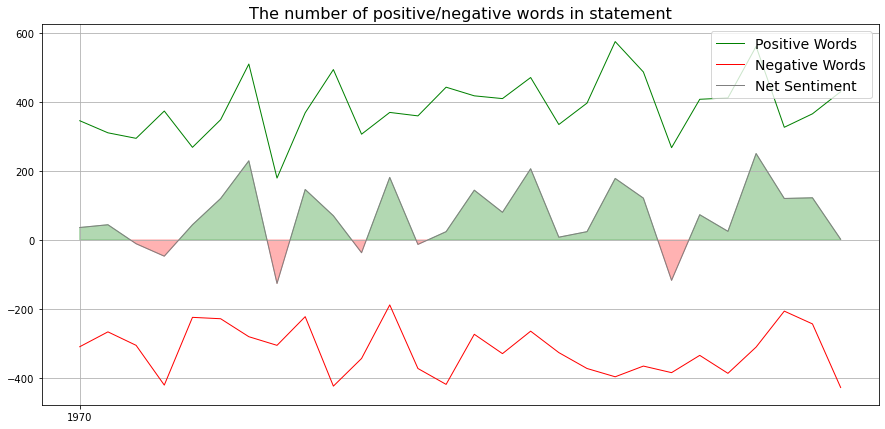

In [24]:
NetSentiment = Data['NPositiveWords'] - Data['NNegativeWords']

plt.figure(figsize=(15,7))
ax = plt.subplot()

plt.plot(Data.index, Data['NPositiveWords'], c='green', linewidth= 1.0)
plt.plot(Data.index, Data['NNegativeWords']*-1, c='red', linewidth=1.0)
plt.plot(Data.index, NetSentiment, c='grey', linewidth=1.0)

plt.title('The number of positive/negative words in statement', fontsize=16)
plt.legend(['Positive Words', 'Negative Words', 'Net Sentiment'], prop={'size': 14}, loc=1)

ax.fill_between(Data.index, NetSentiment, where=(NetSentiment > 0), color='green', alpha=0.3, interpolate=True)
ax.fill_between(Data.index, NetSentiment, where=(NetSentiment <= 0), color='red', alpha=0.3, interpolate=True)

import matplotlib.dates as mdates
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

# format the ticks
ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)
datemin = Data.date[12]
datemax = Data.date[27]

ax.grid(True)

plt.show()

### USA!!!

In [28]:
meeting_scripts_usa = pd.read_csv("../data/dataset/FOMC/meeting_script.csv", index_col=0)
minutes_usa = pd.read_csv("../data/dataset/FOMC/minutes.csv", index_col=0)
presconf_script_usa = pd.read_csv("../data/dataset/FOMC/presconf_script.csv", index_col=0)
speech_usa = pd.read_csv("../data/dataset/FOMC/speech.csv", index_col=0)
statement_usa = pd.read_csv("../data/dataset/FOMC/statement.csv", index_col=0)
testimony_usa = pd.read_csv("../data/dataset/FOMC/testimony.csv", index_col=0)

#### Meeting scripts

In [29]:
print(meeting_scripts_usa.shape)
meeting_scripts_usa.head()

(282, 4)


,date,contents,speaker,title
0,1980-01-09,MR. STERNLIGHT. [Statement--see Appendix.]\n...,other,FOMC Meeting Transcript
1,1980-02-05,CHAIRMAN VOLCKER. I will call the non-meeti...,other,FOMC Meeting Transcript
2,1980-03-18,CHAIRMAN VOLCKER. The meeting can come to ...,other,FOMC Meeting Transcript
3,1980-04-22,"CHAIRMAN VOLCKER. Can we come to order, la...",other,FOMC Meeting Transcript
4,1980-05-20,"CHAIRMAN VOLCKER. Let us proceed, ladies an...",other,FOMC Meeting Transcript


In [30]:
meeting_scripts_usa["processed_text"] = meeting_scripts_usa["contents"]
for i in range(0, meeting_scripts_usa.shape[0]):
    meeting_scripts_usa.processed_text.iloc[i] = preprocess(meeting_scripts_usa.contents.iloc[i].replace("\n", " "))
    

In [31]:
from collections import Counter

fomc_meeting_all_tokens = list(np.concatenate(meeting_scripts_usa.processed_text.to_list()))
fomc_meeting_tokens_count = Counter([token for token in fomc_meeting_all_tokens])
fomc_meeting_tokens = {x: count for x, count in fomc_meeting_tokens_count.items() if len(x)>1}
fomc_meeting_tokens_sorted = dict(sorted(fomc_meeting_tokens.items(), key=lambda x:x[1], reverse=1))

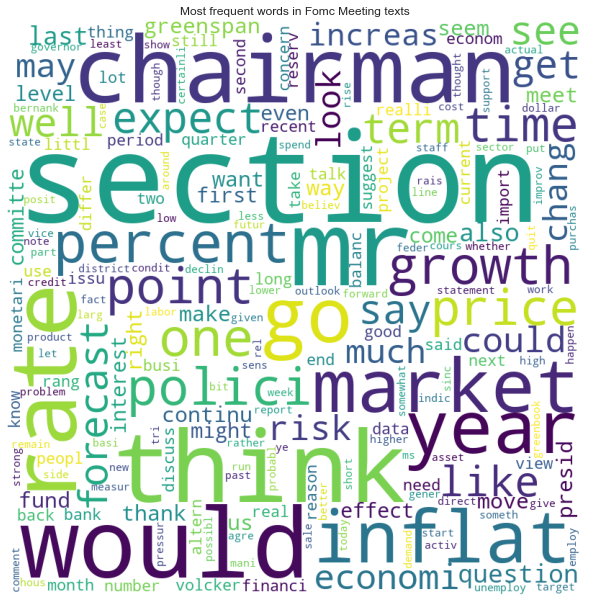

In [266]:
from wordcloud import WordCloud

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate_from_frequencies(fomc_meeting_tokens_sorted)
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Most frequent words in Fomc Meeting texts")
plt.show()

In [267]:
import plotly.express as px

fomc_meeting_tokens_df = pd.DataFrame.from_dict(fomc_meeting_tokens_sorted, orient="index", columns=["word frequency"])

fig = px.bar(fomc_meeting_tokens_df.iloc[30:0:-1], orientation='h', title="Frequency of the top 30 words in the Fomc meeting texts", x="word frequency", labels={'index':'Word'}, color="word frequency")
 
fig.show(renderer="notebook")

In [40]:
fomc_meeting_Data = meeting_scripts_usa
print(len(fomc_meeting_Data))
fomc_meeting_temp = [tone_count_with_negation_check(lmdict,x) for x in fomc_meeting_Data.contents]
fomc_meeting_temp = pd.DataFrame(fomc_meeting_temp)

fomc_meeting_Data['wordcount'] = fomc_meeting_temp.iloc[:,0].values
fomc_meeting_Data['NPositiveWords'] = fomc_meeting_temp.iloc[:,1].values
fomc_meeting_Data['NNegativeWords'] = fomc_meeting_temp.iloc[:,2].values

#Sentiment Score normalized by the number of words
fomc_meeting_Data['sentiment'] = (fomc_meeting_Data['NPositiveWords'] - fomc_meeting_Data['NNegativeWords']) / fomc_meeting_Data['wordcount'] * 100

fomc_meeting_Data['Poswords'] = fomc_meeting_temp.iloc[:,3].values
fomc_meeting_Data['Negwords'] = fomc_meeting_temp.iloc[:,4].values
fomc_meeting_Data = fomc_meeting_Data.reset_index()



282


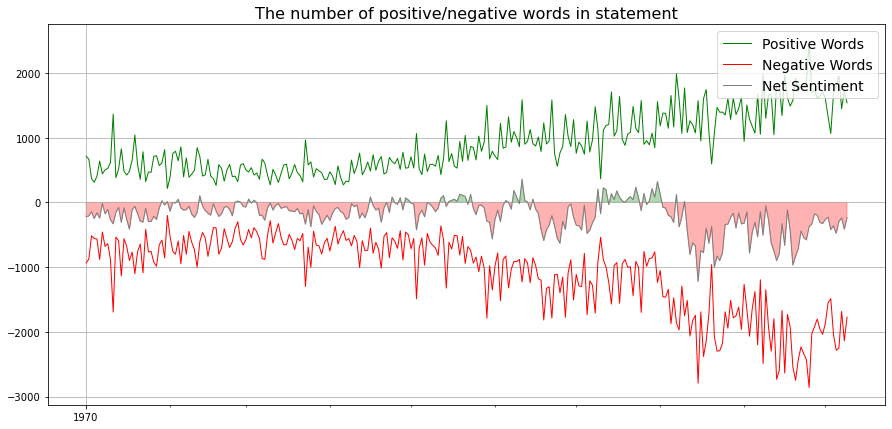

In [42]:
fomc_meeting_NetSentiment = fomc_meeting_Data['NPositiveWords'] - fomc_meeting_Data['NNegativeWords']

plt.figure(figsize=(15,7))
ax = plt.subplot()

plt.plot(fomc_meeting_Data.index, fomc_meeting_Data['NPositiveWords'], c='green', linewidth= 1.0)
plt.plot(fomc_meeting_Data.index, fomc_meeting_Data['NNegativeWords']*-1, c='red', linewidth=1.0)
plt.plot(fomc_meeting_Data.index, fomc_meeting_NetSentiment, c='grey', linewidth=1.0)

plt.title('The number of positive/negative words in statement', fontsize=16)
plt.legend(['Positive Words', 'Negative Words', 'Net Sentiment'], prop={'size': 14}, loc=1)

ax.fill_between(fomc_meeting_Data.index, fomc_meeting_NetSentiment, where=(fomc_meeting_NetSentiment > 0), color='green', alpha=0.3, interpolate=True)
ax.fill_between(fomc_meeting_Data.index, fomc_meeting_NetSentiment, where=(fomc_meeting_NetSentiment <= 0), color='red', alpha=0.3, interpolate=True)

import matplotlib.dates as mdates
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

# format the ticks
ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)
datemin = fomc_meeting_Data.date[0]
datemax = fomc_meeting_Data.date.iloc[-1]

ax.grid(True)

plt.show()

#### Minutes

In [43]:
print(minutes_usa.shape)
minutes_usa.head()

(229, 4)


,date,contents,speaker,title
0,1993-02-03,A meeting of the Federal Open Market Committee...,Alan Greenspan,FOMC Meeting Minutes
1,1993-03-23,A meeting of the Federal Open Market Committee...,Alan Greenspan,FOMC Meeting Minutes
2,1993-05-18,A meeting of the Federal Open Market Committee...,Alan Greenspan,FOMC Meeting Minutes
3,1993-07-07,A meeting of the Federal Open Market Committee...,Alan Greenspan,FOMC Meeting Minutes
4,1993-08-17,A meeting of the Federal Open Market Committee...,Alan Greenspan,FOMC Meeting Minutes


In [44]:
minutes_usa["processed_text"] = minutes_usa["contents"]
for i in range(0, minutes_usa.shape[0]):
    minutes_usa.processed_text.iloc[i] = preprocess(minutes_usa.contents.iloc[i].replace("\n", " "))
    

In [45]:
from collections import Counter

fomc_minutes_all_tokens = list(np.concatenate(minutes_usa.processed_text.to_list()))
fomc_minutes_tokens_count = Counter([token for token in fomc_minutes_all_tokens])
fomc_minutes_tokens = {x: count for x, count in fomc_minutes_tokens_count.items() if len(x)>1}
fomc_minutes_tokens_sorted = dict(sorted(fomc_minutes_tokens.items(), key=lambda x:x[1], reverse=1))

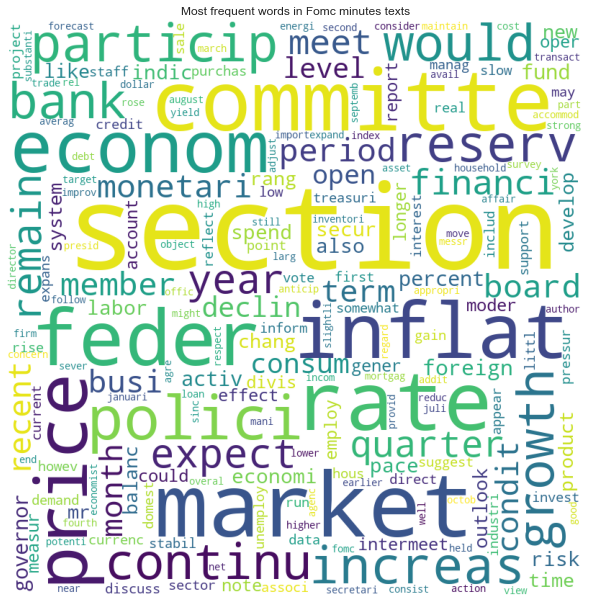

In [269]:
from wordcloud import WordCloud

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate_from_frequencies(fomc_minutes_tokens_sorted)
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Most frequent words in Fomc minutes texts")
 
plt.show()

In [268]:
import plotly.express as px

fomc_minutes_tokens_df = pd.DataFrame.from_dict(fomc_minutes_tokens_sorted, orient="index", columns=["word frequency"])

fig = px.bar(fomc_minutes_tokens_df.iloc[30:0:-1], orientation='h', title="Frequency of top 30 words in the Fomc minutes text", x="word frequency", labels={'index':'Word'}, color="word frequency")
 
fig.show(renderer="notebook")

In [50]:
fomc_minutes_Data = minutes_usa
print(len(fomc_minutes_Data))
fomc_minutes_temp = [tone_count_with_negation_check(lmdict,x) for x in fomc_minutes_Data.contents]
fomc_minutes_temp = pd.DataFrame(fomc_minutes_temp)

fomc_minutes_Data['wordcount'] = fomc_minutes_temp.iloc[:,0].values
fomc_minutes_Data['NPositiveWords'] = fomc_minutes_temp.iloc[:,1].values
fomc_minutes_Data['NNegativeWords'] = fomc_minutes_temp.iloc[:,2].values

#Sentiment Score normalized by the number of words
fomc_minutes_Data['sentiment'] = (fomc_minutes_Data['NPositiveWords'] - fomc_minutes_Data['NNegativeWords']) / fomc_minutes_Data['wordcount'] * 100

fomc_minutes_Data['Poswords'] = fomc_minutes_temp.iloc[:,3].values
fomc_minutes_Data['Negwords'] = fomc_minutes_temp.iloc[:,4].values
fomc_minutes_Data = fomc_minutes_Data.reset_index()




229


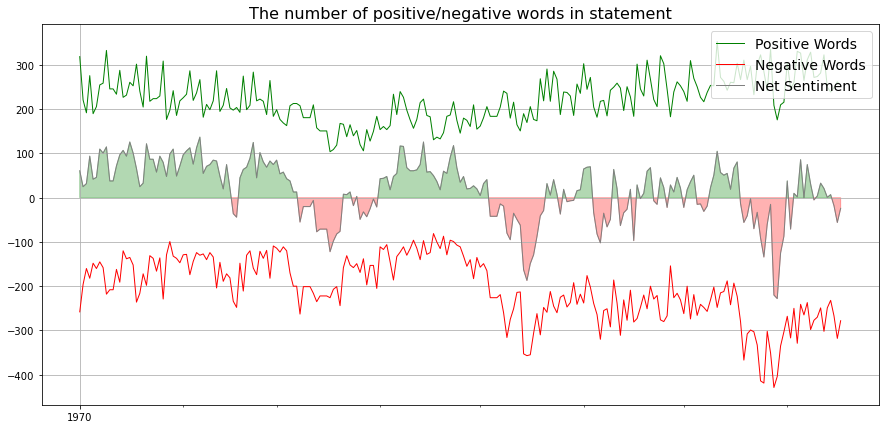

In [52]:
fomc_minutes_NetSentiment = fomc_minutes_Data['NPositiveWords'] - fomc_minutes_Data['NNegativeWords']

plt.figure(figsize=(15,7))
ax = plt.subplot()

plt.plot(fomc_minutes_Data.index, fomc_minutes_Data['NPositiveWords'], c='green', linewidth= 1.0)
plt.plot(fomc_minutes_Data.index, fomc_minutes_Data['NNegativeWords']*-1, c='red', linewidth=1.0)
plt.plot(fomc_minutes_Data.index, fomc_minutes_NetSentiment, c='grey', linewidth=1.0)

plt.title('The number of positive/negative words in statement', fontsize=16)
plt.legend(['Positive Words', 'Negative Words', 'Net Sentiment'], prop={'size': 14}, loc=1)

ax.fill_between(fomc_minutes_Data.index, fomc_minutes_NetSentiment, where=(fomc_minutes_NetSentiment > 0), color='green', alpha=0.3, interpolate=True)
ax.fill_between(fomc_minutes_Data.index, fomc_minutes_NetSentiment, where=(fomc_minutes_NetSentiment <= 0), color='red', alpha=0.3, interpolate=True)

import matplotlib.dates as mdates
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

# format the ticks
ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)
datemin = fomc_minutes_Data.date[0]
datemax = fomc_minutes_Data.date.iloc[-1]

ax.grid(True)

plt.show()

#### Pres conference scripts

In [53]:
print(presconf_script_usa.shape)
presconf_script_usa.head()

(55, 4)


,date,contents,speaker,title
0,2011-04-27,CHAIRMAN BERNANKE. Good afternoon. Welcome. ...,Ben Bernanke,FOMC Press Conference Transcript
1,2011-06-22,CHAIRMAN BERNANKE. Good afternoon and welcome...,Ben Bernanke,FOMC Press Conference Transcript
2,2011-11-02,"CHAIRMAN BERNANKE. Good afternoon, everybody....",Ben Bernanke,FOMC Press Conference Transcript
3,2012-01-25,CHAIRMAN BERNANKE. Good afternoon and welcome...,Ben Bernanke,FOMC Press Conference Transcript
4,2012-04-25,CHAIRMAN BERNANKE. Good afternoon. Before we...,Ben Bernanke,FOMC Press Conference Transcript


In [54]:
presconf_script_usa["processed_text"] = presconf_script_usa["contents"]
for i in range(0, presconf_script_usa.shape[0]):
    presconf_script_usa.processed_text.iloc[i] = preprocess(presconf_script_usa.contents.iloc[i].replace("\n", " "))
    

In [56]:
from collections import Counter

fomc_presconf_all_tokens = list(np.concatenate(presconf_script_usa.processed_text.to_list()))
fomc_presconf_tokens_count = Counter([token for token in fomc_presconf_all_tokens])
fomc_presconf_tokens = {x: count for x, count in fomc_presconf_tokens_count.items() if len(x)>1}
fomc_presconf_tokens_sorted = dict(sorted(fomc_presconf_tokens.items(), key=lambda x:x[1], reverse=1))

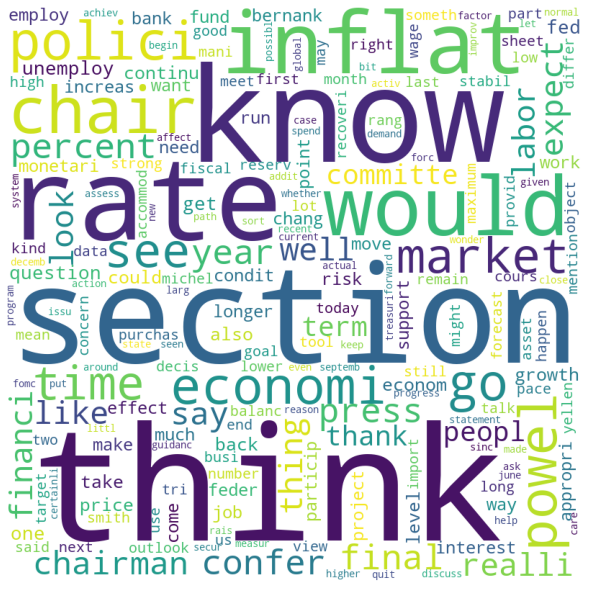

In [57]:
from wordcloud import WordCloud

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate_from_frequencies(fomc_presconf_tokens_sorted)
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Most frequent words in Fomc press conference texts")
 
plt.show()

In [270]:
import plotly.express as px

fomc_presconf_tokens_df = pd.DataFrame.from_dict(fomc_presconf_tokens_sorted, orient="index", columns=["word frequency"])

fig = px.bar(fomc_presconf_tokens_df.iloc[30:0:-1], orientation='h', title="Frequency of the top 30 words in the Fomc press conference textsd", x="word frequency", labels={'index':'Word'}, color="word frequency")
 
fig.show(renderer="notebook")

In [59]:
fomc_presconf_Data = presconf_script_usa
print(len(fomc_presconf_Data))
fomc_presconf_temp = [tone_count_with_negation_check(lmdict,x) for x in fomc_presconf_Data.contents]
fomc_presconf_temp = pd.DataFrame(fomc_presconf_temp)

fomc_presconf_Data['wordcount'] = fomc_presconf_temp.iloc[:,0].values
fomc_presconf_Data['NPositiveWords'] = fomc_presconf_temp.iloc[:,1].values
fomc_presconf_Data['NNegativeWords'] = fomc_presconf_temp.iloc[:,2].values

#Sentiment Score normalized by the number of words
fomc_presconf_Data['sentiment'] = (fomc_presconf_Data['NPositiveWords'] - fomc_presconf_Data['NNegativeWords']) / fomc_presconf_Data['wordcount'] * 100

fomc_presconf_Data['Poswords'] = fomc_presconf_temp.iloc[:,3].values
fomc_presconf_Data['Negwords'] = fomc_presconf_temp.iloc[:,4].values
fomc_presconf_Data = fomc_presconf_Data.reset_index()




55


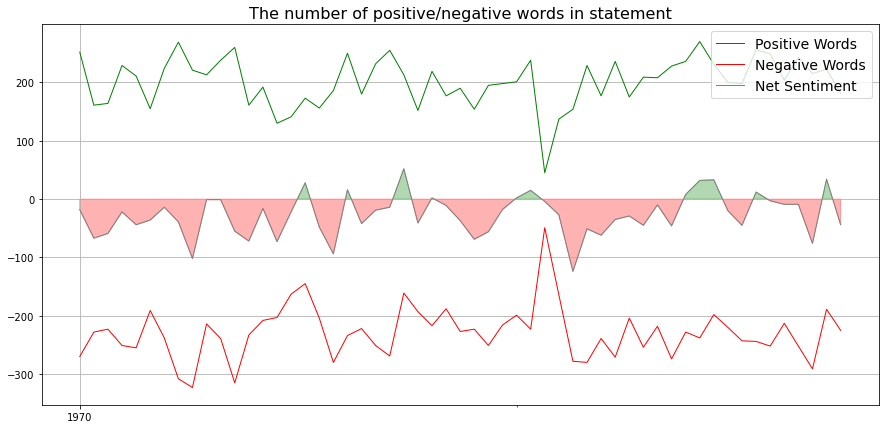

In [60]:
fomc_presconf_NetSentiment = fomc_presconf_Data['NPositiveWords'] - fomc_presconf_Data['NNegativeWords']

plt.figure(figsize=(15,7))
ax = plt.subplot()

plt.plot(fomc_presconf_Data.index, fomc_presconf_Data['NPositiveWords'], c='green', linewidth= 1.0)
plt.plot(fomc_presconf_Data.index, fomc_presconf_Data['NNegativeWords']*-1, c='red', linewidth=1.0)
plt.plot(fomc_presconf_Data.index, fomc_presconf_NetSentiment, c='grey', linewidth=1.0)

plt.title('The number of positive/negative words in statement', fontsize=16)
plt.legend(['Positive Words', 'Negative Words', 'Net Sentiment'], prop={'size': 14}, loc=1)

ax.fill_between(fomc_presconf_Data.index, fomc_presconf_NetSentiment, where=(fomc_presconf_NetSentiment > 0), color='green', alpha=0.3, interpolate=True)
ax.fill_between(fomc_presconf_Data.index, fomc_presconf_NetSentiment, where=(fomc_presconf_NetSentiment <= 0), color='red', alpha=0.3, interpolate=True)

import matplotlib.dates as mdates
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

# format the ticks
ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)
datemin = fomc_presconf_Data.date[0]
datemax = fomc_presconf_Data.date.iloc[-1]

ax.grid(True)

plt.show()

#### Speech

In [63]:
print(speech_usa.shape)
speech_usa = speech_usa.dropna()
speech_usa.head()

(1607, 5)


,date,contents,speaker,title,processed_text
0,1996-06-13,Remarks by Chairman Alan Greenspan\nBank super...,Chairman Alan Greenspan,Bank supervision in a world economy,"[remark, chairman, alan, greenspan, bank, supe..."
1,1996-06-18,"Remarks by Governor Edward W. Kelley, Jr.\nDev...","Governor Edward W. Kelley, Jr.",Developments in electronic money and banking,"[remark, governor, edward, w, kelley, jr, deve..."
2,1996-09-08,Monetary Policy Objectives and Strategy\n\n[SE...,Governor Laurence H. Meyer,Monetary policy objectives and strategy,"[monetari, polici, object, strategi, section, ..."
3,1996-09-19,Remarks by Chairman Alan Greenspan\nRegulation...,Chairman Alan Greenspan,Regulation and electronic payment systems,"[remark, chairman, alan, greenspan, regul, ele..."
4,1996-10-02,Remarks by Governor Lawrence B. Lindsey\r\nAt ...,Governor Lawrence B. Lindsey,Small business is big business,"[remark, governor, lawrenc, b, lindsey, small,..."


In [64]:
speech_usa["processed_text"] = speech_usa["contents"]
for i in range(0, speech_usa.shape[0]):
    try:
        speech_usa.processed_text.iloc[i] = preprocess(speech_usa.contents.iloc[i].replace("\n", " "))
    except AttributeError:
        print(speech_usa.contentes.iloc[i])
    

In [65]:
from collections import Counter

fomc_speech_all_tokens = list(np.concatenate(speech_usa.processed_text.to_list()))
fomc_speech_tokens_count = Counter([token for token in fomc_speech_all_tokens])
fomc_speech_tokens = {x: count for x, count in fomc_speech_tokens_count.items() if len(x)>1}
fomc_speech_tokens_sorted = dict(sorted(fomc_speech_tokens.items(), key=lambda x:x[1], reverse=1))

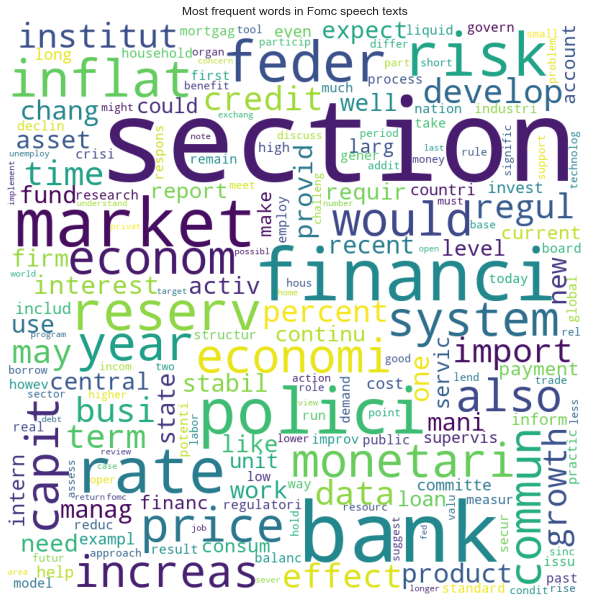

In [271]:
from wordcloud import WordCloud

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate_from_frequencies(fomc_speech_tokens_sorted)
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Most frequent words in Fomc speech texts")
plt.show()

In [273]:
import plotly.express as px

fomc_speech_tokens_df = pd.DataFrame.from_dict(fomc_speech_tokens_sorted, orient="index", columns=["word frequency"])

fig = px.bar(fomc_speech_tokens_df.iloc[30:0:-1], orientation='h', title="Frequency of the top 30 words in the Fomc speech texts", x="word frequency", labels={'index':'Word'}, color="word frequency")
 
fig.show(renderer="notebook")

In [71]:
fomc_speech_temp.head()

,date,contents,speaker,title,processed_text,wordcount,NPositiveWords,NNegativeWords
0,1996-06-13,Remarks by Chairman Alan Greenspan\nBank super...,Chairman Alan Greenspan,Bank supervision in a world economy,"[remark, chairman, alan, greenspan, bank, supe...",1996-06-13,Remarks by Chairman Alan Greenspan\nBank super...,Chairman Alan Greenspan
1,1996-06-18,"Remarks by Governor Edward W. Kelley, Jr.\nDev...","Governor Edward W. Kelley, Jr.",Developments in electronic money and banking,"[remark, governor, edward, w, kelley, jr, deve...",1996-06-18,"Remarks by Governor Edward W. Kelley, Jr.\nDev...","Governor Edward W. Kelley, Jr."
2,1996-09-08,Monetary Policy Objectives and Strategy\n\n[SE...,Governor Laurence H. Meyer,Monetary policy objectives and strategy,"[monetari, polici, object, strategi, section, ...",1996-09-08,Monetary Policy Objectives and Strategy\n\n[SE...,Governor Laurence H. Meyer
3,1996-09-19,Remarks by Chairman Alan Greenspan\nRegulation...,Chairman Alan Greenspan,Regulation and electronic payment systems,"[remark, chairman, alan, greenspan, regul, ele...",1996-09-19,Remarks by Chairman Alan Greenspan\nRegulation...,Chairman Alan Greenspan
4,1996-10-02,Remarks by Governor Lawrence B. Lindsey\r\nAt ...,Governor Lawrence B. Lindsey,Small business is big business,"[remark, governor, lawrenc, b, lindsey, small,...",1996-10-02,Remarks by Governor Lawrence B. Lindsey\r\nAt ...,Governor Lawrence B. Lindsey


In [72]:
fomc_speech_Data = speech_usa
print(len(fomc_speech_Data))
fomc_speech_temp = [tone_count_with_negation_check(lmdict,x) for x in fomc_speech_Data.contents]
fomc_speech_temp = pd.DataFrame(fomc_speech_temp)

fomc_speech_Data['wordcount'] = fomc_speech_temp.iloc[:,0].values
fomc_speech_Data['NPositiveWords'] = fomc_speech_temp.iloc[:,1].values
fomc_speech_Data['NNegativeWords'] = fomc_speech_temp.iloc[:,2].values

#Sentiment Score normalized by the number of words
fomc_speech_Data['sentiment'] = (fomc_speech_Data['NPositiveWords'] - fomc_speech_Data['NNegativeWords']) / fomc_speech_Data['wordcount'] * 100

fomc_speech_Data['Poswords'] = fomc_speech_temp.iloc[:,3].values
fomc_speech_Data['Negwords'] = fomc_speech_temp.iloc[:,4].values
fomc_speech_Data = fomc_speech_Data.reset_index()




1599


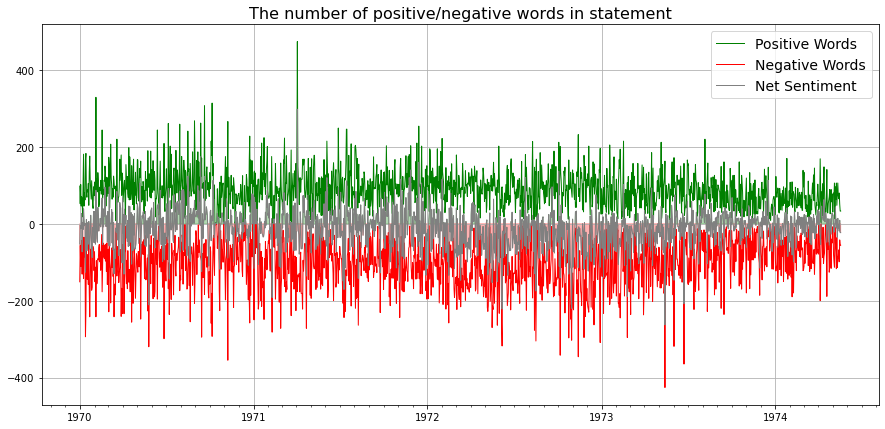

In [73]:
fomc_speech_NetSentiment = fomc_speech_Data['NPositiveWords'] - fomc_speech_Data['NNegativeWords']

plt.figure(figsize=(15,7))
ax = plt.subplot()

plt.plot(fomc_speech_Data.index, fomc_speech_Data['NPositiveWords'], c='green', linewidth= 1.0)
plt.plot(fomc_speech_Data.index, fomc_speech_Data['NNegativeWords']*-1, c='red', linewidth=1.0)
plt.plot(fomc_speech_Data.index, fomc_speech_NetSentiment, c='grey', linewidth=1.0)

plt.title('The number of positive/negative words in statement', fontsize=16)
plt.legend(['Positive Words', 'Negative Words', 'Net Sentiment'], prop={'size': 14}, loc=1)

ax.fill_between(fomc_speech_Data.index, fomc_speech_NetSentiment, where=(fomc_speech_NetSentiment > 0), color='green', alpha=0.3, interpolate=True)
ax.fill_between(fomc_speech_Data.index, fomc_speech_NetSentiment, where=(fomc_speech_NetSentiment <= 0), color='red', alpha=0.3, interpolate=True)

import matplotlib.dates as mdates
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

# format the ticks
ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)
datemin = fomc_speech_Data.date[0]
datemax = fomc_speech_Data.date.iloc[-1]

ax.grid(True)

plt.show()

#### Statements

In [74]:
print(statement_usa.shape)
statement_usa.head()

(201, 4)


,date,contents,speaker,title
0,1994-02-04,\n\n[SECTION]\n\nChairman Alan Greenspan annou...,Alan Greenspan,FOMC Statement
1,1994-03-22,\n\n[SECTION]\n\nChairman Alan Greenspan annou...,Alan Greenspan,FOMC Statement
2,1994-04-18,\n\n[SECTION]\n\nChairman Alan Greenspan annou...,Alan Greenspan,FOMC Statement
3,1994-05-17,\n\n[SECTION]\n\nThe Federal Reserve today ann...,Alan Greenspan,FOMC Statement
4,1994-08-16,\n\n[SECTION]\n\nThe Federal Reserve announced...,Alan Greenspan,FOMC Statement


In [75]:
statement_usa["processed_text"] = statement_usa["contents"]
for i in range(0, statement_usa.shape[0]):
    statement_usa.processed_text.iloc[i] = preprocess(statement_usa.contents.iloc[i].replace("\n", " "))
    

In [76]:
from collections import Counter

fomc_statements_all_tokens = list(np.concatenate(statement_usa.processed_text.to_list()))
fomc_statements_tokens_count = Counter([token for token in fomc_statements_all_tokens])
fomc_statements_tokens = {x: count for x, count in fomc_statements_tokens_count.items() if len(x)>1}
fomc_statements_tokens_sorted = dict(sorted(fomc_statements_tokens.items(), key=lambda x:x[1], reverse=1))

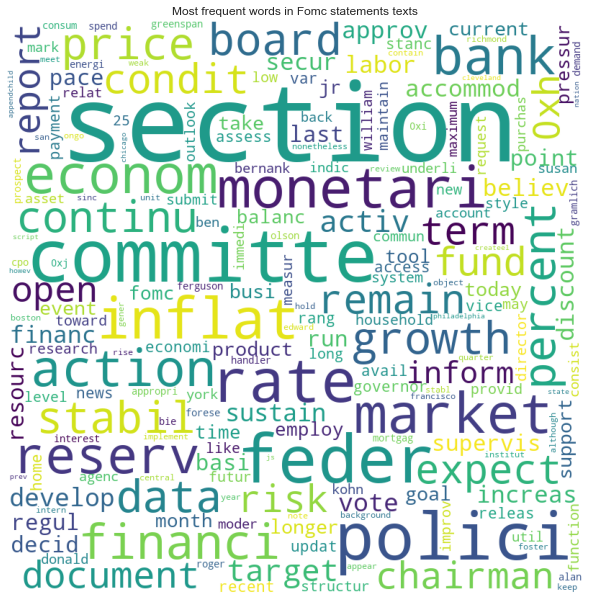

In [274]:
from wordcloud import WordCloud

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate_from_frequencies(fomc_statements_tokens_sorted)
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Most frequent words in Fomc statements texts")
plt.show()

In [276]:
import plotly.express as px

fomc_statements_tokens_df = pd.DataFrame.from_dict(fomc_statements_tokens_sorted, orient="index", columns=["word frequency"])

fig = px.bar(fomc_statements_tokens_df.iloc[30:0:-1], title="Frequency of the top 30 words of the Fomc statements texts", orientation='h', x="word frequency", labels={'index':'Word'}, color="word frequency")
 
fig.show(renderer="notebook")

In [79]:
fomc_statements_Data = statement_usa
print(len(fomc_statements_Data))
fomc_statements_temp = [tone_count_with_negation_check(lmdict,x) for x in fomc_statements_Data.contents]
fomc_statements_temp = pd.DataFrame(fomc_statements_temp)

fomc_statements_Data['wordcount'] = fomc_statements_temp.iloc[:,0].values
fomc_statements_Data['NPositiveWords'] = fomc_statements_temp.iloc[:,1].values
fomc_statements_Data['NNegativeWords'] = fomc_statements_temp.iloc[:,2].values

#Sentiment Score normalized by the number of words
fomc_statements_Data['sentiment'] = (fomc_statements_Data['NPositiveWords'] - fomc_statements_Data['NNegativeWords']) / fomc_statements_Data['wordcount'] * 100

fomc_statements_Data['Poswords'] = fomc_statements_temp.iloc[:,3].values
fomc_statements_Data['Negwords'] = fomc_statements_temp.iloc[:,4].values
fomc_statements_Data = fomc_statements_Data.reset_index()




201


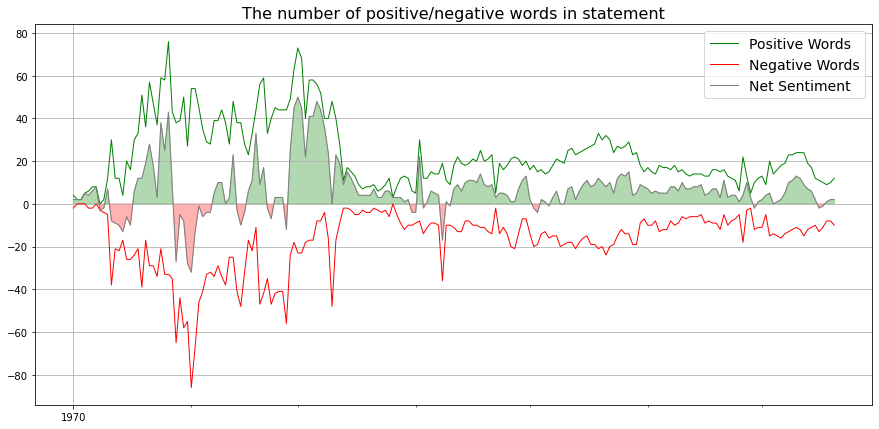

In [80]:
fomc_statements_NetSentiment = fomc_statements_Data['NPositiveWords'] - fomc_statements_Data['NNegativeWords']

plt.figure(figsize=(15,7))
ax = plt.subplot()

plt.plot(fomc_statements_Data.index, fomc_statements_Data['NPositiveWords'], c='green', linewidth= 1.0)
plt.plot(fomc_statements_Data.index, fomc_statements_Data['NNegativeWords']*-1, c='red', linewidth=1.0)
plt.plot(fomc_statements_Data.index, fomc_statements_NetSentiment, c='grey', linewidth=1.0)

plt.title('The number of positive/negative words in statement', fontsize=16)
plt.legend(['Positive Words', 'Negative Words', 'Net Sentiment'], prop={'size': 14}, loc=1)

ax.fill_between(fomc_statements_Data.index, fomc_statements_NetSentiment, where=(fomc_statements_NetSentiment > 0), color='green', alpha=0.3, interpolate=True)
ax.fill_between(fomc_statements_Data.index, fomc_statements_NetSentiment, where=(fomc_statements_NetSentiment <= 0), color='red', alpha=0.3, interpolate=True)

import matplotlib.dates as mdates
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

# format the ticks
ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)
datemin = fomc_statements_Data.date[0]
datemax = fomc_statements_Data.date.iloc[-1]

ax.grid(True)

plt.show()

#### Testimony

In [81]:
print(testimony_usa.shape)
testimony_usa.head()

(456, 4)


,date,contents,speaker,title
0,1996-06-26,\n\n[SECTION]\n\n\n\n[SECTION]\n\n\n\n[SECTION...,"Governor Edward W. Kelley, Jr.",Supervision of bank sales practices
1,1996-07-17,\n\n[SECTION]\n\n\n\n[SECTION]\n\n\n\n[SECTION...,"Herbert A. Biern, Deputy Associate Director, D...","""Prime bank"" schemes"
2,1996-07-18,Testimony of Chairman Alan Greenspan\nThe Fede...,Chairman Alan Greenspan,The Federal Reserve's semiannual monetary report
3,1996-07-24,\n\n[SECTION]\n\n\n\n[SECTION]\n\n\n\n[SECTION...,Governor Janet L. Yellen,Trends in consumer lending
4,1996-07-26,\n\n[SECTION]\n\n\n\n[SECTION]\n\n\n\n[SECTION...,Chairman Alan Greenspan,Recent reports on Federal Reserve operations


In [82]:
testimony_usa["processed_text"] = testimony_usa["contents"]
for i in range(0, testimony_usa.shape[0]):
    testimony_usa.processed_text.iloc[i] = preprocess(testimony_usa.contents.iloc[i].replace("\n", " "))
    

In [83]:
from collections import Counter

fomc_testimony_all_tokens = list(np.concatenate(testimony_usa.processed_text.to_list()))
fomc_testimony_tokens_count = Counter([token for token in fomc_testimony_all_tokens])
fomc_testimony_tokens = {x: count for x, count in fomc_testimony_tokens_count.items() if len(x)>1}
fomc_testimony_tokens_sorted = dict(sorted(fomc_testimony_tokens.items(), key=lambda x:x[1], reverse=1))

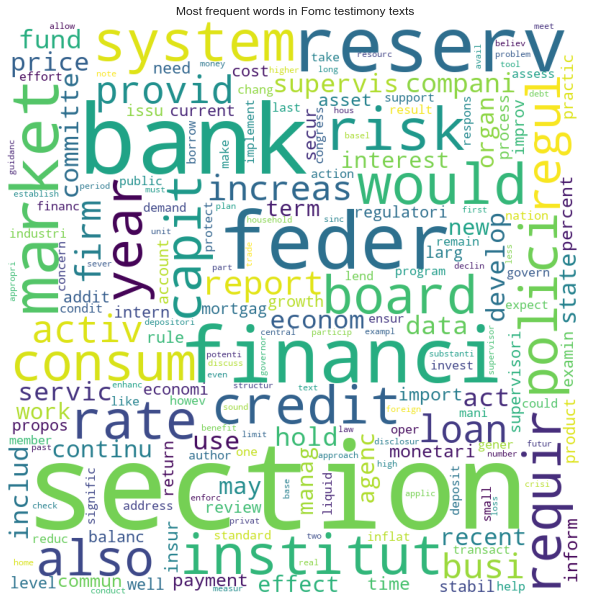

In [279]:
from wordcloud import WordCloud

wordcloud = WordCloud(width = 800, height = 800, background_color ='white', min_font_size = 10).generate_from_frequencies(fomc_testimony_tokens_sorted)
plt.figure(figsize = (8, 8), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Most frequent words in Fomc testimony texts")
plt.show()

In [278]:
import plotly.express as px

fomc_testimony_tokens_df = pd.DataFrame.from_dict(fomc_testimony_tokens_sorted, orient="index", columns=["word frequency"])

fig = px.bar(fomc_testimony_tokens_df.iloc[30:0:-1], title="Frequency of the top 30 words in the Fomc Testimony texts", orientation='h', x="word frequency", labels={'index':'Word'}, color="word frequency")
 
fig.show(renderer="notebook")

In [86]:
fomc_testimony_Data = meeting_scripts_usa
print(len(fomc_testimony_Data))
fomc_testimony_temp = [tone_count_with_negation_check(lmdict,x) for x in fomc_testimony_Data.contents]
fomc_testimony_temp = pd.DataFrame(fomc_testimony_temp)

fomc_testimony_Data['wordcount'] = fomc_testimony_temp.iloc[:,0].values
fomc_testimony_Data['NPositiveWords'] = fomc_testimony_temp.iloc[:,1].values
fomc_testimony_Data['NNegativeWords'] = fomc_testimony_temp.iloc[:,2].values

#Sentiment Score normalized by the number of words
fomc_testimony_Data['sentiment'] = (fomc_testimony_Data['NPositiveWords'] - fomc_testimony_Data['NNegativeWords']) / fomc_testimony_Data['wordcount'] * 100

fomc_testimony_Data['Poswords'] = fomc_testimony_temp.iloc[:,3].values
fomc_testimony_Data['Negwords'] = fomc_testimony_temp.iloc[:,4].values
fomc_testimony_Data = fomc_testimony_Data.reset_index()




282


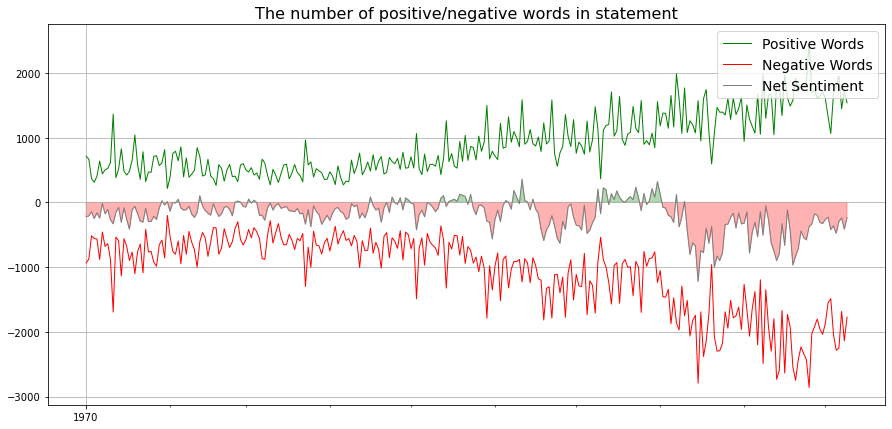

In [87]:
fomc_testimony_NetSentiment = fomc_testimony_Data['NPositiveWords'] - fomc_testimony_Data['NNegativeWords']

plt.figure(figsize=(15,7))
ax = plt.subplot()

plt.plot(fomc_testimony_Data.index, fomc_testimony_Data['NPositiveWords'], c='green', linewidth= 1.0)
plt.plot(fomc_testimony_Data.index, fomc_testimony_Data['NNegativeWords']*-1, c='red', linewidth=1.0)
plt.plot(fomc_testimony_Data.index, fomc_testimony_NetSentiment, c='grey', linewidth=1.0)

plt.title('The number of positive/negative words in statement', fontsize=16)
plt.legend(['Positive Words', 'Negative Words', 'Net Sentiment'], prop={'size': 14}, loc=1)

ax.fill_between(fomc_testimony_Data.index, fomc_testimony_NetSentiment, where=(fomc_testimony_NetSentiment > 0), color='green', alpha=0.3, interpolate=True)
ax.fill_between(fomc_testimony_Data.index, fomc_testimony_NetSentiment, where=(fomc_testimony_NetSentiment <= 0), color='red', alpha=0.3, interpolate=True)

import matplotlib.dates as mdates
years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

# format the ticks
ax.xaxis.set_major_locator(years)
ax.xaxis.set_major_formatter(years_fmt)
ax.xaxis.set_minor_locator(months)
datemin = fomc_testimony_Data.date[0]
datemax = fomc_testimony_Data.date.iloc[-1]

ax.grid(True)

plt.show()

### Market Data

#### Fill market data values with last value

In [135]:
market_data_df = pd.read_csv("../data/dataset/agglomerate/agglomerate.csv", index_col=0)

In [136]:
# Only keep data until October (cant use data after that)
market_data_df.sort_index(inplace=True)
market_data_df = market_data_df.iloc[:-40]
print(market_data_df.shape)
print(f"Market Data ranging from {market_data_df.index[0]} to {market_data_df.index[-1]}")
market_data_df.head(10)

(2096, 38)
Market Data ranging from 2017-01-04 to 2022-10-31


,w.bcpi_BCPI_WEEKLY,w.bcne_BCPI_WEEKLY,w.ener_BCPI_WEEKLY,w.mtls_BCPI_WEEKLY,w.fopr_BCPI_WEEKLY,w.agri_BCPI_WEEKLY,w.fish_BCPI_WEEKLY,unnamed: 0_CA.-interest_rate,v39078_CA.-interest_rate,unnamed: 0_U.S.-interest_rate,...,3 mo_USTREASURY_YIELD,6 mo_USTREASURY_YIELD,1 yr_USTREASURY_YIELD,2 yr_USTREASURY_YIELD,3 yr_USTREASURY_YIELD,5 yr_USTREASURY_YIELD,7 yr_USTREASURY_YIELD,10 yr_USTREASURY_YIELD,20 yr_USTREASURY_YIELD,30 yr_USTREASURY_YIELD
date,,,,,,,,,,,,,,,,,,,,,
2017-01-04,393.77,303.21,951.91,488.66,356.42,207.02,1293.84,1307.0,0.75,261.0,...,0.53,0.63,0.87,1.24,1.50,1.94,2.26,2.46,2.78,3.05
2017-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1308.0,0.75,NaN,...,0.52,0.62,0.83,1.17,1.43,1.86,2.18,2.37,2.69,2.96
2017-01-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1309.0,0.75,NaN,...,0.53,0.61,0.85,1.22,1.50,1.92,2.23,2.42,2.73,3.00
2017-01-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1310.0,0.75,NaN,...,0.50,0.60,0.82,1.21,1.47,1.89,2.18,2.38,2.69,2.97
2017-01-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1311.0,0.75,NaN,...,0.52,0.60,0.82,1.19,1.47,1.89,2.18,2.38,2.69,2.97
2017-01-11,394.70,306.27,947.37,495.98,354.37,209.70,1329.93,1312.0,0.75,262.0,...,0.52,0.60,0.82,1.20,1.47,1.89,2.18,2.38,2.68,2.96
2017-01-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1313.0,0.75,NaN,...,0.52,0.59,0.81,1.18,1.45,1.87,2.17,2.36,2.68,3.01


In [137]:
market_data_df.tail()

,w.bcpi_BCPI_WEEKLY,w.bcne_BCPI_WEEKLY,w.ener_BCPI_WEEKLY,w.mtls_BCPI_WEEKLY,w.fopr_BCPI_WEEKLY,w.agri_BCPI_WEEKLY,w.fish_BCPI_WEEKLY,unnamed: 0_CA.-interest_rate,v39078_CA.-interest_rate,unnamed: 0_U.S.-interest_rate,...,3 mo_USTREASURY_YIELD,6 mo_USTREASURY_YIELD,1 yr_USTREASURY_YIELD,2 yr_USTREASURY_YIELD,3 yr_USTREASURY_YIELD,5 yr_USTREASURY_YIELD,7 yr_USTREASURY_YIELD,10 yr_USTREASURY_YIELD,20 yr_USTREASURY_YIELD,30 yr_USTREASURY_YIELD
date,,,,,,,,,,,,,,,,,,,,,
2022-10-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2817.0,3.5,NaN,...,4.14,4.50,4.60,4.42,4.45,4.25,4.17,4.10,4.45,4.26
2022-10-26,658.19,465.53,1533.97,775.82,520.11,339.04,1722.21,2818.0,3.5,564.0,...,4.11,4.47,4.54,4.39,4.41,4.20,4.12,4.04,4.38,4.19
2022-10-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2819.0,4.0,NaN,...,4.13,4.44,4.50,4.30,4.29,4.09,4.01,3.96,4.32,4.12
2022-10-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2820.0,4.0,NaN,...,4.18,4.51,4.55,4.41,4.38,4.19,4.10,4.02,4.38,4.15
2022-10-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2821.0,4.0,NaN,...,4.22,4.57,4.66,4.51,4.45,4.27,4.18,4.10,4.44,4.22


In [144]:
columns = list(market_data_df.columns)
for column in columns:
    new_values = []
    last_value = -1
    for i in range(0, market_data_df.shape[0]):
        if np.isnan(market_data_df[column].iloc[i]):
            new_values.append(last_value)
        else:
            last_value = market_data_df[column].iloc[i]
            new_values.append(last_value)
    market_data_df[column] = new_values

In [147]:
market_data_df.to_csv("../data/dataset/agglomerate/agglomerate_fill_last_value.csv")

#### Fill market data values with range between last value and next value

In [208]:
market_data_df = pd.read_csv("../data/dataset/agglomerate/agglomerate.csv", index_col=0)

In [209]:
# Only keep data until October (cant use data after that)
market_data_df.sort_index(inplace=True)
market_data_df = market_data_df.iloc[:-40]
print(market_data_df.shape)
print(f"Market Data ranging from {market_data_df.index[0]} to {market_data_df.index[-1]}")
market_data_df.head(10)

(2096, 38)
Market Data ranging from 2017-01-04 to 2022-10-31


,w.bcpi_BCPI_WEEKLY,w.bcne_BCPI_WEEKLY,w.ener_BCPI_WEEKLY,w.mtls_BCPI_WEEKLY,w.fopr_BCPI_WEEKLY,w.agri_BCPI_WEEKLY,w.fish_BCPI_WEEKLY,unnamed: 0_CA.-interest_rate,v39078_CA.-interest_rate,unnamed: 0_U.S.-interest_rate,...,3 mo_USTREASURY_YIELD,6 mo_USTREASURY_YIELD,1 yr_USTREASURY_YIELD,2 yr_USTREASURY_YIELD,3 yr_USTREASURY_YIELD,5 yr_USTREASURY_YIELD,7 yr_USTREASURY_YIELD,10 yr_USTREASURY_YIELD,20 yr_USTREASURY_YIELD,30 yr_USTREASURY_YIELD
date,,,,,,,,,,,,,,,,,,,,,
2017-01-04,393.77,303.21,951.91,488.66,356.42,207.02,1293.84,1307.0,0.75,261.0,...,0.53,0.63,0.87,1.24,1.50,1.94,2.26,2.46,2.78,3.05
2017-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1308.0,0.75,NaN,...,0.52,0.62,0.83,1.17,1.43,1.86,2.18,2.37,2.69,2.96
2017-01-06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1309.0,0.75,NaN,...,0.53,0.61,0.85,1.22,1.50,1.92,2.23,2.42,2.73,3.00
2017-01-07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-08,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1310.0,0.75,NaN,...,0.50,0.60,0.82,1.21,1.47,1.89,2.18,2.38,2.69,2.97
2017-01-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1311.0,0.75,NaN,...,0.52,0.60,0.82,1.19,1.47,1.89,2.18,2.38,2.69,2.97
2017-01-11,394.70,306.27,947.37,495.98,354.37,209.70,1329.93,1312.0,0.75,262.0,...,0.52,0.60,0.82,1.20,1.47,1.89,2.18,2.38,2.68,2.96
2017-01-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1313.0,0.75,NaN,...,0.52,0.59,0.81,1.18,1.45,1.87,2.17,2.36,2.68,3.01


In [210]:
market_data_df.tail()

,w.bcpi_BCPI_WEEKLY,w.bcne_BCPI_WEEKLY,w.ener_BCPI_WEEKLY,w.mtls_BCPI_WEEKLY,w.fopr_BCPI_WEEKLY,w.agri_BCPI_WEEKLY,w.fish_BCPI_WEEKLY,unnamed: 0_CA.-interest_rate,v39078_CA.-interest_rate,unnamed: 0_U.S.-interest_rate,...,3 mo_USTREASURY_YIELD,6 mo_USTREASURY_YIELD,1 yr_USTREASURY_YIELD,2 yr_USTREASURY_YIELD,3 yr_USTREASURY_YIELD,5 yr_USTREASURY_YIELD,7 yr_USTREASURY_YIELD,10 yr_USTREASURY_YIELD,20 yr_USTREASURY_YIELD,30 yr_USTREASURY_YIELD
date,,,,,,,,,,,,,,,,,,,,,
2022-10-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2817.0,3.5,NaN,...,4.14,4.50,4.60,4.42,4.45,4.25,4.17,4.10,4.45,4.26
2022-10-26,658.19,465.53,1533.97,775.82,520.11,339.04,1722.21,2818.0,3.5,564.0,...,4.11,4.47,4.54,4.39,4.41,4.20,4.12,4.04,4.38,4.19
2022-10-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2819.0,4.0,NaN,...,4.13,4.44,4.50,4.30,4.29,4.09,4.01,3.96,4.32,4.12
2022-10-28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2820.0,4.0,NaN,...,4.18,4.51,4.55,4.41,4.38,4.19,4.10,4.02,4.38,4.15
2022-10-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2821.0,4.0,NaN,...,4.22,4.57,4.66,4.51,4.45,4.27,4.18,4.10,4.44,4.22


In [211]:
columns

['w.bcpi_BCPI_WEEKLY',
 'w.bcne_BCPI_WEEKLY',
 'w.ener_BCPI_WEEKLY',
 'w.mtls_BCPI_WEEKLY',
 'w.fopr_BCPI_WEEKLY',
 'w.agri_BCPI_WEEKLY',
 'w.fish_BCPI_WEEKLY',
 'unnamed: 0_CA.-interest_rate',
 'v39078_CA.-interest_rate',
 'unnamed: 0_U.S.-interest_rate',
 'v121820_U.S.-interest_rate',
 'value_FRED_CPIAUCSL',
 'value_FRED_DFEDTARL',
 'value_FRED_DFEDTARU',
 'value_FRED_DFF',
 'value_FRED_GDPC1',
 'value_FRED_GDPPOT',
 'value_FRED_HSN1F',
 'value_FRED_PAYEMS',
 'value_FRED_PCEPILFE',
 'value_FRED_RRSFS',
 'value_FRED_UNRATE',
 'fxusdcad_FXUSDCAD_rsi',
 'rsi_FXUSDCAD_rsi',
 'pmi_ISM_MAN_PMI',
 'index_ISM_NONMAN_NMI',
 '1 mo_USTREASURY_YIELD',
 '2 mo_USTREASURY_YIELD',
 '3 mo_USTREASURY_YIELD',
 '6 mo_USTREASURY_YIELD',
 '1 yr_USTREASURY_YIELD',
 '2 yr_USTREASURY_YIELD',
 '3 yr_USTREASURY_YIELD',
 '5 yr_USTREASURY_YIELD',
 '7 yr_USTREASURY_YIELD',
 '10 yr_USTREASURY_YIELD',
 '20 yr_USTREASURY_YIELD',
 '30 yr_USTREASURY_YIELD']

In [212]:
columns = list(market_data_df.columns)
for column in columns:
    new_values = []
    last_value = market_data_df[column].iloc[0]
    next_value = -1
    the_range = 0
    for i in range(0, market_data_df.shape[0]):
        if np.isnan(market_data_df[column].iloc[i]):
            the_range += 1
        else:
            the_range += 1
            next_value = market_data_df[column].iloc[i]
            new_values += list(np.linspace(last_value, next_value, the_range+1))[1:]
            the_range = 0
            last_value = next_value
        if i==market_data_df.shape[0]-1 and the_range!=0:
            new_values += [last_value]*the_range
    market_data_df[column] = new_values

In [213]:
market_data_df.head(10)

,w.bcpi_BCPI_WEEKLY,w.bcne_BCPI_WEEKLY,w.ener_BCPI_WEEKLY,w.mtls_BCPI_WEEKLY,w.fopr_BCPI_WEEKLY,w.agri_BCPI_WEEKLY,w.fish_BCPI_WEEKLY,unnamed: 0_CA.-interest_rate,v39078_CA.-interest_rate,unnamed: 0_U.S.-interest_rate,...,3 mo_USTREASURY_YIELD,6 mo_USTREASURY_YIELD,1 yr_USTREASURY_YIELD,2 yr_USTREASURY_YIELD,3 yr_USTREASURY_YIELD,5 yr_USTREASURY_YIELD,7 yr_USTREASURY_YIELD,10 yr_USTREASURY_YIELD,20 yr_USTREASURY_YIELD,30 yr_USTREASURY_YIELD
date,,,,,,,,,,,,,,,,,,,,,
2017-01-04,393.770000,303.210000,951.910000,488.660000,356.420000,207.020000,1293.840000,1307.000000,0.75,261.000000,...,0.53,0.630000,0.87,1.240000,1.50,1.94,2.260000,2.460000,2.780000,3.05
2017-01-05,393.902857,303.647143,951.261429,489.705714,356.127143,207.402857,1298.995714,1308.000000,0.75,261.142857,...,0.52,0.620000,0.83,1.170000,1.43,1.86,2.180000,2.370000,2.690000,2.96
2017-01-06,394.035714,304.084286,950.612857,490.751429,355.834286,207.785714,1304.151429,1309.000000,0.75,261.285714,...,0.53,0.610000,0.85,1.220000,1.50,1.92,2.230000,2.420000,2.730000,3.00
2017-01-07,394.168571,304.521429,949.964286,491.797143,355.541429,208.168571,1309.307143,1309.333333,0.75,261.428571,...,0.52,0.606667,0.84,1.216667,1.49,1.91,2.213333,2.406667,2.716667,2.99
2017-01-08,394.301429,304.958571,949.315714,492.842857,355.248571,208.551429,1314.462857,1309.666667,0.75,261.571429,...,0.51,0.603333,0.83,1.213333,1.48,1.90,2.196667,2.393333,2.703333,2.98
2017-01-09,394.434286,305.395714,948.667143,493.888571,354.955714,208.934286,1319.618571,1310.000000,0.75,261.714286,...,0.50,0.600000,0.82,1.210000,1.47,1.89,2.180000,2.380000,2.690000,2.97
2017-01-10,394.567143,305.832857,948.018571,494.934286,354.662857,209.317143,1324.774286,1311.000000,0.75,261.857143,...,0.52,0.600000,0.82,1.190000,1.47,1.89,2.180000,2.380000,2.690000,2.97
2017-01-11,394.700000,306.270000,947.370000,495.980000,354.370000,209.700000,1329.930000,1312.000000,0.75,262.000000,...,0.52,0.600000,0.82,1.200000,1.47,1.89,2.180000,2.380000,2.680000,2.96
2017-01-12,395.265714,307.011429,947.797143,497.230000,355.254286,210.222857,1329.930000,1313.000000,0.75,262.142857,...,0.52,0.590000,0.81,1.180000,1.45,1.87,2.170000,2.360000,2.680000,3.01


In [214]:
market_data_df.to_csv("../data/dataset/agglomerate/agglomerate_fill_with_range.csv")

In [258]:
df2 = market_data_df.corr()

In [259]:
import seaborn as sns
%matplotlib inline
sns.set(rc={'figure.figsize':(13,13)})
df2 = df2.drop(market_data_df.columns[12]).drop(market_data_df.columns[12], axis=1)
df2 = df2.drop(market_data_df.columns[13]).drop(market_data_df.columns[13], axis=1)


In [260]:
df2 = df2.drop(market_data_df.columns[-11:]).drop(market_data_df.columns[-11:], axis=1)

In [261]:
df2 = df2.drop(market_data_df.columns[7]).drop(market_data_df.columns[7], axis=1)
df2 = df2.drop(market_data_df.columns[9]).drop(market_data_df.columns[9], axis=1)

<AxesSubplot:title={'center':'Correlation between market data'}>

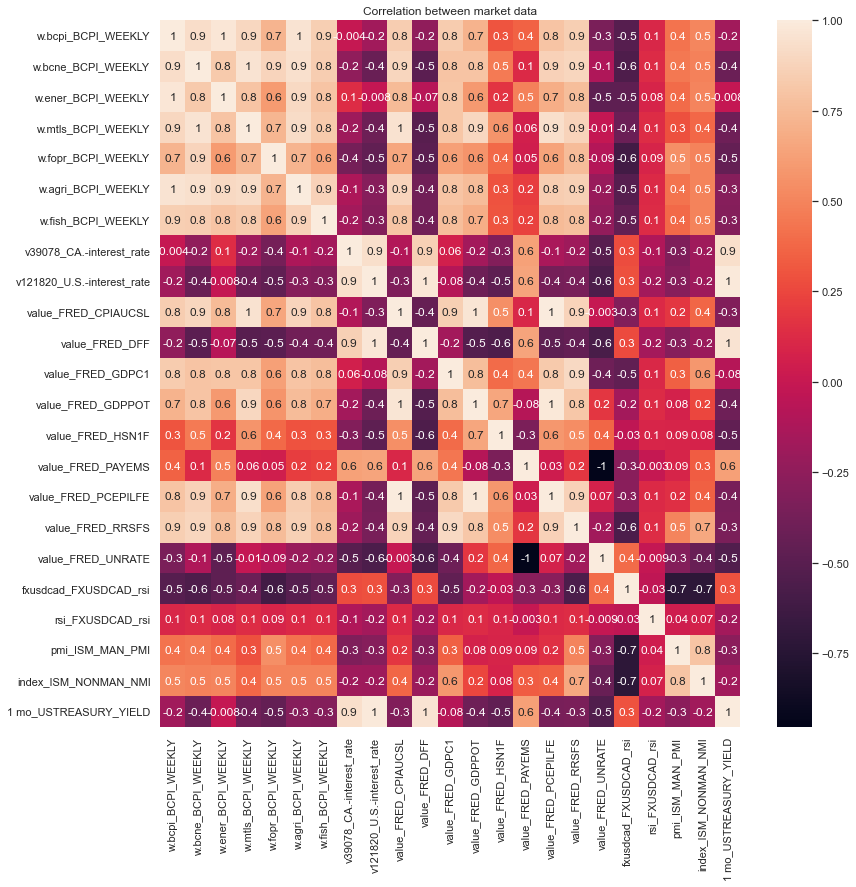

In [280]:
plt.title("Correlation between market data")
sns.heatmap(df2, annot=True, fmt=".1g")

In [235]:
market_data_df["unnamed: 0_CA.-interest_rate"]

date
2017-01-04    1307.000000
2017-01-05    1308.000000
2017-01-06    1309.000000
2017-01-07    1309.333333
2017-01-08    1309.666667
                 ...     
2022-10-25    2817.000000
2022-10-26    2818.000000
2022-10-27    2819.000000
2022-10-28    2820.000000
2022-10-31    2821.000000
Name: unnamed: 0_CA.-interest_rate, Length: 2096, dtype: float64

In [236]:
market_data_df["unnamed: 0_U.S.-interest_rate"]

date
2017-01-04    261.000000
2017-01-05    261.142857
2017-01-06    261.285714
2017-01-07    261.428571
2017-01-08    261.571429
                 ...    
2022-10-25    563.800000
2022-10-26    564.000000
2022-10-27    564.000000
2022-10-28    564.000000
2022-10-31    564.000000
Name: unnamed: 0_U.S.-interest_rate, Length: 2096, dtype: float64

## saving relevant features and filling nans

In [10]:
market_data_df = pd.read_csv("../data/dataset/agglomerate/agglomerate_fill_with_range.csv")


In [11]:
market_data_df = market_data_df.drop(market_data_df.columns[13], axis=1)
market_data_df = market_data_df.drop(market_data_df.columns[12], axis=1)
market_data_df = market_data_df.drop(market_data_df.columns[-11:], axis=1)
market_data_df = market_data_df.drop(["unnamed: 0_CA.-interest_rate","unnamed: 0_U.S.-interest_rate"], axis=1)
market_data_df = market_data_df.fillna(method='bfill')

In [7]:
market_data_df.to_csv("../data/dataset/agglomerate/agglomerate_fill_with_range_v2.csv")

In [14]:
len(market_data_df.columns)

24